<a href="https://colab.research.google.com/github/OswaldFlores/Interpretable-Machine-Learning-with-Python/blob/master/Copy_of_UsedCars.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Used Cars Price Prediction
#### CHAPTER 4: _Global Model-Agnostic Interpretation Methods_
##### From **Interpretable Machine Learning with Python 2nd Edition** by Serg Masís, published by Packt

> we will explore the notion of feature importance by examining the model’s inherent parameters. Following that, we will study how to employ permutation feature importance in a model-agnostic manner to effectively, reliably, and autonomously rank features. Finally, we will outline how SHapley Additive exPlanations (SHAP) can rectify some of the shortcomings of permutation feature importance.


### This notebook will focus on:
- What is feature importance
- Gauging feature importance with model-agnostic methods
- Using SHAP, PDP, and ALE plots to visualize:
    - Global explanations
    - Feature summary explanations
    - Feature interactions

### The Approach
1. Train a couple of models
2. Evaluate them
3. Create feature importance values using several methods, both model-specific and model-agnostic
4. Plot global summaries, feature summaries, and feature interaction plots to understand how these features relate to the outcome and each other

The plots will help you communicate the findings

## The Preparations

### Installing the Libraries

### Loading the Libraries

In [1]:
! pip install machine_learning_datasets
! pip install shap
! pip install pdpbox
! pip install PyALE
! pip install lime
! pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.0/45.0 kB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 8.6 MB/s eta 0:00:00
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.13.1
    Uninstalling seaborn-0.13.1:
      Successfully uninstalled seaborn-0.13.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.7/535.7 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.8/35.8 MB 34.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 68.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
import math
import os, random
import numpy as np
import pandas as pd
import machine_learning_datasets as mldatasets

from sklearn import metrics, ensemble, tree, inspection, model_selection
import catboost as cb

import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import shap
from pdpbox import pdp, info_plots
from PyALE import ale
from lime.lime_tabular import LimeTabularExplainer

### Understanding and Preparing the Data

In [3]:
usedcars_df = mldatasets.load("usedcars", prepare=True)

https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python-2E/raw/main/datasets/usedcars-2e.csv.zip downloaded to /content/data/usedcars-2e.csv.zip
/content/data/usedcars-2e.csv.zip uncompressed to /content/data/usedcars-2e.csv
1 dataset files found in /content/data/usedcars-2e.csv folder
parsing /content/data/usedcars-2e.csv/usedcars_imputed.csv


In [4]:
usedcars_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   price                            256065 non-null  int64  
 1   region                           256065 non-null  object 
 2   posting_date                     256065 non-null  object 
 3   lat                              256065 non-null  float64
 4   long                             256065 non-null  float64
 5   state                            256065 non-null  object 
 6   city                             256065 non-null  object 
 7   zip                              256065 non-null  object 
 8   make                             256065 non-null  object 
 9   make_cat                         256065 non-null  object 
 10  make_pop                         256065 non-null  float64
 11  model                            256065 non-null  ob

The data dictionary for the dataset is as follows:

**Variables related to the listing:**

- price: target, continuous, the price posted for the vehicle

- region: categorical, the region for the listing— usually this is a city, metropolitan area, or (for more rural areas) a portion of a state or a least populated state (out of 402)

- posting_date: datetime, the date and time of the posting (all postings are for a single month period in 2021 so you cannot observe seasonal patterns with it)

- lat: continuous, the latitude in decimal format
- long: continuous, the longitude in decimal format
- state: categorical, the two-letter state code (out of 51 including [DC])
- city: categorical, the name of the city (out of over 6,700)
- zip: nominal, the zip code (out of over 13,100)

**Variables related to the vehicle:**
- make: categorical, the brand or manufacturer of the vehicle (out of 37)
- make_cat: categorical, the category for the make (out of 5). It’s [obsolete] for makes no longer produced, such as “Saturn,” [luxury sports] for brands like “Ferrari,” and [luxury] for brands like “Mercedes-Benz.” Everything else is [regular] or [premium]. The only difference is that [premium] include brands like “Cadillac” and “Acura,” which are the high-end brands of car manufacturers in the [regular] category.
- make_pop: continuous, the relative popularity of the make in percentiles (0– 1)
- model: categorical, the model (out of over 17,000)
- model_premier: binary, whether the model is a luxury version/ trim of a model (if the model itself is not already high-end such as those in the luxury, luxury sports, or premium categories)
- year: ordinal, the year of the model (from 1984– 2022)
- make_yr_pop: continuous, the relative popularity of the make for the year it was made for in percentiles (0– 1)
- model_yr_pop: continuous, the relative popularity of the model for the year it was made in percentiles (0– 1)
- odometer: continuous, the reading in the vehicle’s odometer
- auto_trans: binary, whether the car has automatic transmission— otherwise, it is manual
- fuel: categorical, the type of fuel used (out of 5: [gas], [diesel], [hybrid], [electric] and [other])
- model_type: categorical (out of 13: [sedan], [SUV], and [pickup] are the three most popular, by far)
- drive: categorical, whether it’s four-wheel, front-wheel, or rear-wheel drive (out of 3: [4wd], [fwd] and [rwd])
- cylinders: nominal, the number of cylinders of the engine (from 2– 16). Generally, the more cylinders, the higher the horsepower
- title_status: categorical, what the title says about the status of the vehicle (out of 7 like [clean], [rebuilt], [unknown], [salvage], and [lien])
- condition: categorical, what the owner reported the condition of the vehicle to be (out of 7 like [good], [unknown], [excellent] and [like new])

**Variables related to the emissions of the vehicle:**

- epa_co2: continuous, tailpipe CO2 in grams/ mile. For models after 2013, it is based on EPA tests. For previous years, CO2 is estimated using an EPA emission factor (-1 = not vvailable)
- epa_displ: continuous, the engine displacement (in liters 0.6– 8.4)

**Variables related to the ZIP code of the listing:**
- zip_population: continuous, the population
- zip_density: continuous, the density (residents per sq. mile)
- est_households_medianincome_usd: continuous, the median household income

In [71]:
original_used_cars = mldatasets.load("usedcars", prepare=True)

https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python-2E/raw/main/datasets/usedcars-2e.csv.zip downloaded to /content/data/usedcars-2e.csv.zip
/content/data/usedcars-2e.csv.zip uncompressed to /content/data/usedcars-2e.csv
1 dataset files found in /content/data/usedcars-2e.csv folder
parsing /content/data/usedcars-2e.csv/usedcars_imputed.csv


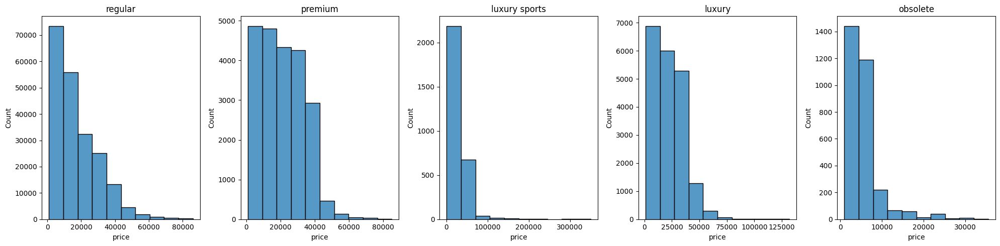

In [73]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a figure with 5 subplots
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 5))

# Iterate through each category in make_cat
for i, category in enumerate(original_used_cars['make_cat'].unique()):
    # Select rows for the current category
    category_data = original_used_cars[original_used_cars['make_cat'] == category]

    # Create a histogram of the price for the current category
    sns.histplot(data=category_data, x='price', bins=10, ax=axes[i])
    axes[i].set_title(category)

# Adjust the spacing between subplots
plt.tight_layout()

# Display the figure
plt.show()


In [77]:
# prompt: for original_used_cars make an statistical description summary (like the pandas describe function) of the price for each category in make_cat

import pandas as pd

# Group the data by make_cat
grouped_data = original_used_cars.groupby('make_cat')

# Calculate the descriptive statistics for price for each make_cat
price_summary = grouped_data['price'].describe()

# Print the price summary
display (price_summary)


,count,mean,std,min,25%,50%,75%,max
make_cat,,,,,,,,
luxury,19860.0,22263.109416,13630.912326,1000.0,10999.0,19998.0,31590.0,131950.0
luxury sports,2944.0,31612.387228,23882.545775,1000.0,23590.0,29990.0,35990.0,349999.0
obsolete,3049.0,5470.009839,4009.563152,1000.0,3400.0,4497.0,5995.0,35500.0
premium,21885.0,21189.397761,12302.146333,1000.0,10000.0,20497.0,30590.0,84950.0
regular,208327.0,17382.268688,12864.271705,1000.0,7000.0,13995.0,24990.0,86000.0


In [83]:
grouped_data ['price'].mean()

make_cat
luxury           22263.109416
luxury sports    31612.387228
obsolete          5470.009839
premium          21189.397761
regular          17382.268688
Name: price, dtype: float64

In [5]:
usedcars_orig_df = usedcars_df.copy()
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'fuel',\
                                                  min_recs=500, defcatname='other')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'make_cat')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'model_type',\
                                                  min_recs=500, defcatname='other')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'condition',\
                                                  min_recs=200, defcatname='other')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'drive')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'title_status',\
                                                  min_recs=500, defcatname='other')

In [68]:
usedcars_orig_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   price                            256065 non-null  int64  
 1   region                           256065 non-null  object 
 2   posting_date                     256065 non-null  object 
 3   lat                              256065 non-null  float64
 4   long                             256065 non-null  float64
 5   state                            256065 non-null  object 
 6   city                             256065 non-null  object 
 7   zip                              256065 non-null  object 
 8   make                             256065 non-null  object 
 9   make_cat                         256065 non-null  object 
 10  make_pop                         256065 non-null  float64
 11  model                            256065 non-null  ob

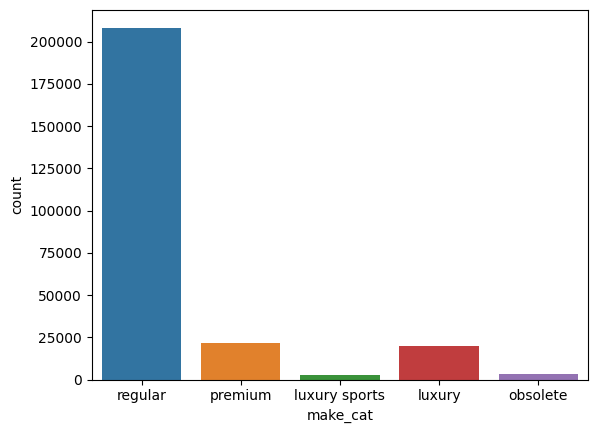

In [70]:
# prompt: for make_cat make a count plot

sns.countplot(x="make_cat", data=usedcars_orig_df)
plt.show()


> Get rid of uninformative variables

As for the make and model, we have the make and model popularity and category features.

In [6]:
usedcars_df.dtypes[lambda x: x == object].index.tolist()

['region', 'posting_date', 'state', 'city', 'zip', 'make', 'model']

In [7]:
usedcars_df = usedcars_df.select_dtypes(include=(int,float,np.uint8))

In [8]:
rand = 42
os.environ['PYTHONHASHSEED']=str(rand)
np.random.seed(rand)
random.seed(rand)

target_col = 'price'

X = usedcars_df.drop([target_col], axis=1)
y = usedcars_df[target_col]

X_train, X_test, y_train, y_test =\
        model_selection.train_test_split(X, y, test_size=0.25, random_state=rand)

In [9]:
y_test.describe()

count     64017.000000
mean      18050.585110
std       13147.678938
min        1000.000000
25%        7500.000000
50%       14900.000000
75%       25999.000000
max      227995.000000
Name: price, dtype: float64

> Transformed Dataset X

In [10]:
y_train.mean()

18127.092357119054

In [11]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 52 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   lat                              256065 non-null  float64
 1   long                             256065 non-null  float64
 2   make_pop                         256065 non-null  float64
 3   model_premier                    256065 non-null  int64  
 4   year                             256065 non-null  int64  
 5   make_yr_pop                      256065 non-null  float64
 6   model_yr_pop                     256065 non-null  float64
 7   odometer                         256065 non-null  float64
 8   auto_trans                       256065 non-null  int64  
 9   cylinders                        256065 non-null  int64  
 10  epa_co2                          256065 non-null  float64
 11  epa_displ                        256065 non-null  fl

## Model Training & Evaluation

> Train CatBoost and Random Forest classifiers

In [12]:
cb_mdl = cb.CatBoostRegressor(depth=7, learning_rate=0.2,\
                               random_state=rand, verbose=False)
cb_mdl = cb_mdl.fit(X_train, y_train)

rf_mdl = ensemble.RandomForestRegressor(n_jobs=-1, random_state=rand)
rf_mdl = rf_mdl.fit(X_train.to_numpy(), y_train.to_numpy())

> CatBoost Classifier (Predicted VS Actual)

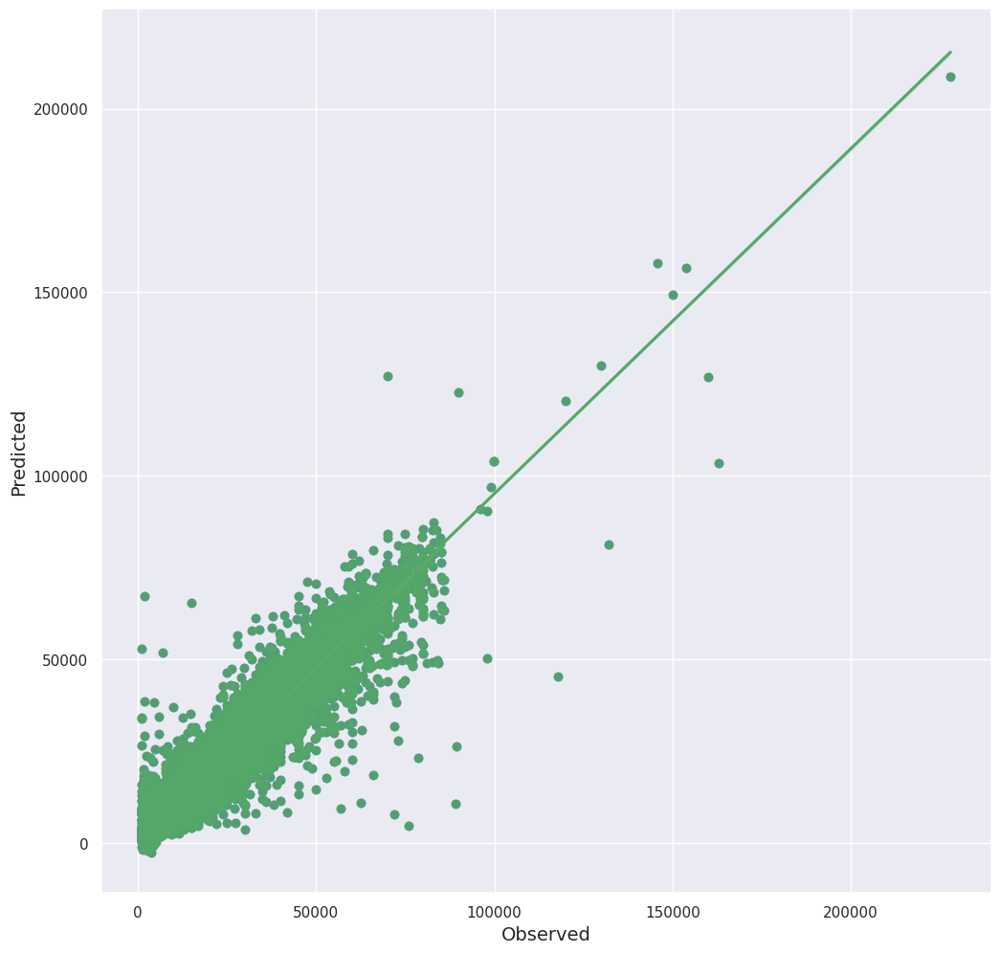

RMSE_train: 2543.4672	RMSE_test: 3099.8195	r2: 0.9444


In [13]:
mdl = cb_mdl

sns.set()
y_train_pred, y_test_pred =\
        mldatasets.evaluate_reg_mdl(mdl, X_train, X_test, y_train, y_test,
        )

> The CatBoost model produced a high R-squared of 0.94 and a test RMSE of nearly 3,100. The regression plot in Figure 4.1 tells us that although there are quite a few cases that have an extremely high error, the vast majority of the 64,000 test samples were predicted fairly well.

In [14]:
thresh = 4000
pct_under = np.where(np.abs(y_test - y_test_pred) < thresh, 1, 0).sum() / len(y_test)
print(f"Percentage of test samples under ${thresh:,.0f} in absolute error {pct_under:.1%}")

Percentage of test samples under $4,000 in absolute error 89.9%


> Random Forest Classifier (Predicted VS Actual)

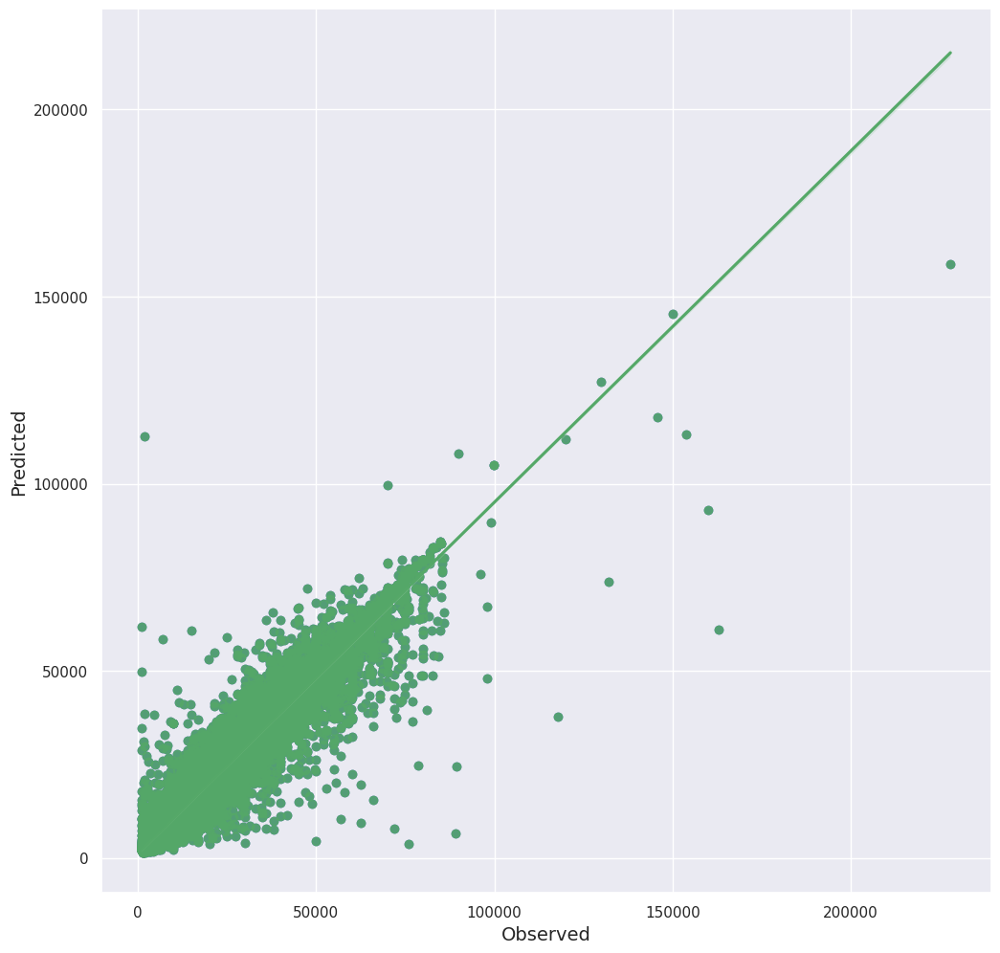

RMSE_train: 1158.2029	RMSE_test: 3074.9148	r2: 0.9453


In [15]:
mdl = rf_mdl

sns.set()
_, _ =\
        mldatasets.evaluate_reg_mdl(mdl, X_train, X_test, y_train, y_test)

> The Random Forest performs just as well for the test samples, and its metrics are remarkably similar to CatBoost, except it overfits much more in this case. This matters because we will now compare some feature importance methods on both and don’t want differences in predictive performance to be a reason to doubt any findings.

## What is feature importance?

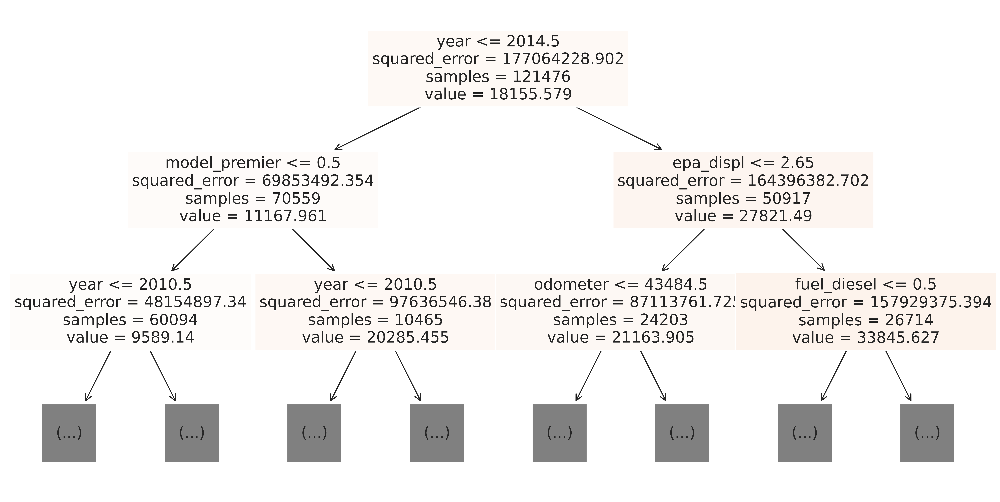

In [16]:
fig, axes = plt.subplots(nrows = 1, ncols = 1, figsize = (16,8), dpi=600)
tree.plot_tree(rf_mdl.estimators_[1], feature_names=X_train.columns,\
               filled = True, max_depth=2, fontsize=14)
fig.show()

> MSE is the impurity measure. It’s expected to decrease as you go deeper in the tree, so the sum of these weighted impurity decreases is calculated for each feature throughout the tree. How much a feature decreases node impurity indicates how much it contributes to the model’s outcome. This would be a model-specific method since it can’t be used with linear models or neural networks, but this is precisely how tree-based models compute feature importance. Random Forest is no different. However, it’s an ensemble, so it has a collection of estimators, so the feature importance is the mean decrease in impurity across all estimators.

In [17]:
rf_feat_imp = rf_mdl.feature_importances_
print(rf_feat_imp)

[8.27435826e-03 1.05316891e-02 2.41376641e-02 5.91421757e-02
 4.59888312e-01 2.36497116e-02 1.73254921e-02 9.41039384e-02
 1.13595842e-03 2.44903039e-02 1.52845147e-02 1.17932359e-01
 6.68909617e-03 7.26970607e-03 6.49519448e-03 3.73906562e-02
 3.35077351e-05 2.08595484e-03 1.06105564e-04 7.35524118e-04
 3.71629481e-03 1.37587550e-03 3.62514722e-05 1.35433058e-03
 1.85942291e-02 2.25594767e-03 4.58569071e-04 5.88135573e-04
 1.17333990e-04 3.57957275e-04 1.04637636e-03 1.85825529e-02
 3.04228803e-03 2.76059120e-03 6.61424708e-04 6.88477978e-05
 1.32533130e-03 5.57300537e-04 7.98286843e-03 7.95490983e-04
 1.21376943e-04 2.40284349e-05 1.40877926e-03 5.16139425e-03
 5.76593121e-03 1.65879364e-03 1.98557685e-03 1.89424809e-04
 3.60991098e-05 6.94700818e-04 2.98266787e-04 2.75408128e-04]


In [18]:
sum(rf_feat_imp)

0.9999999999999999

> CatBoost uses a different method to computer feature importance called : PredictionValuesChange. It shows how much, on average, the model outcome changes if the feature value changes. It traverses the tree performing a weighted average of feature contributions according to the number of nodes in each branch (left or right). If it encounters a combination of features in a node, it evenly assigns contributions to each one. As a result, it can yield misleading feature importance values for features that usually interact with one another.


In [19]:
cb_feat_imp = cb_mdl.feature_importances_
print(cb_feat_imp)

[1.23241338e+00 1.47250731e+00 5.10854175e+00 5.06215588e+00
 2.32428685e+01 2.49396877e+00 2.34425124e+00 1.30525170e+01
 3.62293240e-01 5.05852371e+00 4.02843847e+00 9.94625509e+00
 5.91470586e-01 6.56065556e-01 6.44118827e-01 6.15577710e+00
 4.52983204e-03 4.43591782e-01 1.97928036e-02 1.13317838e-01
 9.36855026e-01 7.15847753e-01 1.45702595e-02 1.50436254e-01
 3.20122608e+00 4.66538937e-01 4.35409660e-02 5.65100050e-02
 1.20649331e-02 7.26020698e-02 2.57216240e-01 3.41471177e+00
 8.61301597e-01 4.76814546e-01 1.41586247e-01 1.53973282e-02
 7.93089927e-02 1.52855942e-01 1.92784381e+00 9.89543927e-02
 5.87334128e-03 6.15126282e-03 4.08901733e-01 8.85913922e-01
 2.52940402e+00 3.18871605e-01 2.40918949e-01 2.57587858e-02
 3.64708812e-03 2.48937147e-01 1.27365951e-01 6.86744613e-02]


In [20]:
sum(cb_feat_imp)

100.0

In [21]:
feat_imp_df = pd.DataFrame({'feature':X_train.columns, 'cb_feat_imp':cb_feat_imp,\
                            'rf_feat_imp':rf_feat_imp*100})
feat_imp_df = feat_imp_df.sort_values('cb_feat_imp', ascending=False)
feat_imp_df.style.format('{:.2f}%', subset=['cb_feat_imp', 'rf_feat_imp']).\
                bar(subset=['cb_feat_imp', 'rf_feat_imp'], color='#4EF', width=60)

,feature,cb_feat_imp,rf_feat_imp
4,year,23.24%,45.99%
7,odometer,13.05%,9.41%
11,epa_displ,9.95%,11.79%
15,fuel_diesel,6.16%,3.74%
2,make_pop,5.11%,2.41%
3,model_premier,5.06%,5.91%
9,cylinders,5.06%,2.45%
10,epa_co2,4.03%,1.53%
31,model_type_pickup,3.41%,1.86%
24,make_cat_regular,3.20%,1.86%


> Notice that both models have the same most important feature in Figure 4.3. The top ten features are mostly the same but not in the same rank. In particular, odometer appears to be much more important for CatBoost than for Random Forest. Also, all the other features don’t match up in ranking except for the least important ones, for which there’s a consensus that they are indeed last: How can we address these differences and employ a technique that consistently represents a feature’s importance? We will explore this using model-agnostic approaches.

# Assessing Feature Importance with Model-agnostic Methods

Model-agnostic methods imply that we will not depend on intrinsic model parameters to compute feature importance. Instead, we will consider the model as a black box, with only the inputs and output visible. So, how can we determine which inputs made a difference?

What if we altered the inputs randomly? Indeed, one of the most effective methods for evaluating feature importance is through simulations designed to measure a feature’s impact or lack thereof. In other words, let’s remove a random player from the game and observe the outcome! In this section, we will discuss two ways to achieve this: permutation feature importance and SHAP.

## Permutation Feature Importance

Once we have a trained model, we cannot remove a feature to assess the impact of not using it. However, we can:

Replace the feature with a static value, such as the mean or median, rendering it devoid of useful information.

Shuffle (permute) the feature values to disrupt the relationship between the feature and the outcome.

Permutation feature importance (permutation_importance) uses the second strategy with a test dataset. Then it measures a change in the score (MSE, r2, f1, accuracy, etc.). In this case, a substantial decrease in the negative Mean Absolute Error (MAE) when the feature is shuffled would suggest that the feature has a high influence on the prediction. It would have to repeat the shuffling several times (n_repeats) to arrive at conclusive results by averaging out the decreases in accuracy. Please note the default scorer for Random Forest regressors is R-squared, while it’s RMSE for CatBoost, so we are making sure they both use the same scorer by setting the scoring parameter. The following code does all of this for both models

In [22]:
%%time
X_samp = X_test.sample(frac=0.3)
y_samp = y_test.loc[X_samp.index]

cb_perm_imp = inspection.permutation_importance(cb_mdl, X_samp, y_samp,\
                                              n_repeats=5, random_state=rand,\
                                              scoring='neg_mean_absolute_error')
rf_perm_imp = inspection.permutation_importance(rf_mdl, X_samp.to_numpy(),\
                                              y_samp.to_numpy(), n_repeats=5,\
                                              random_state=rand,
                                              scoring='neg_mean_absolute_error')

CPU times: user 6min, sys: 3.25 s, total: 6min 4s
Wall time: 3min 31s


In [23]:
perm_imp_df = pd.DataFrame({'feature':X_train.columns,
                            'cb_perm_mean':cb_perm_imp.importances_mean,\
                            'cb_perm_std':cb_perm_imp.importances_std,\
                            'rf_perm_mean':rf_perm_imp.importances_mean,\
                            'rf_perm_std':rf_perm_imp.importances_std})
perm_imp_df = perm_imp_df.sort_values('cb_perm_mean', ascending=False)
perm_imp_df.style.format('{:.4f}', subset=['cb_perm_mean', 'cb_perm_std',
                                           'rf_perm_mean', 'rf_perm_std']).\
                                   bar(subset=['cb_perm_mean',
                                  'rf_perm_mean'],  color='#4EF', width=60)

,feature,cb_perm_mean,cb_perm_std,rf_perm_mean,rf_perm_std
4,year,5469.6114,17.8537,6381.3891,14.3311
7,odometer,3029.2987,16.3274,3289.6996,22.4841
11,epa_displ,1330.7051,16.0213,2191.0799,25.1505
9,cylinders,1049.3324,10.0008,1217.5801,16.4082
2,make_pop,996.2043,7.1443,521.5881,6.8384
3,model_premier,580.0383,13.7382,1149.4696,15.5622
10,epa_co2,558.8655,3.1452,720.9986,14.3755
31,model_type_pickup,548.2176,8.2829,539.4135,4.2696
5,make_yr_pop,546.1205,3.6921,488.1375,6.4764
24,make_cat_regular,483.7597,5.6140,703.0490,12.2885


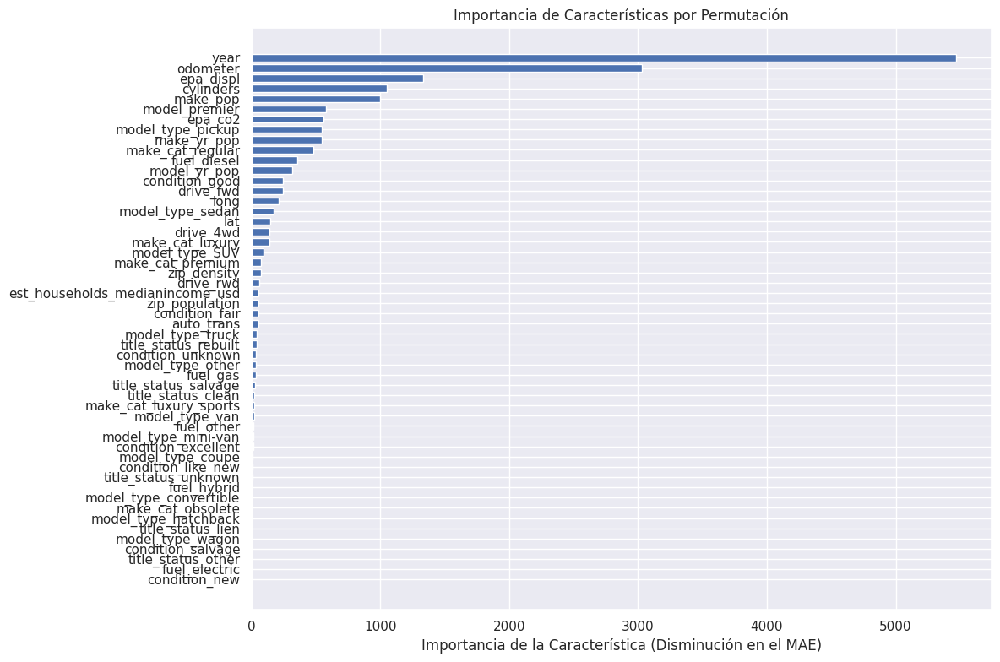

In [24]:
import matplotlib.pyplot as plt

# Asumiendo que 'cb_perm_imp' es el objeto devuelto por 'permutation_importance'
# y 'X_samp' es un DataFrame con las columnas correspondientes a las características

# Obtener la importancia media y los índices de las características ordenados por importancia
perm_sorted_idx = cb_perm_imp.importances_mean.argsort()

# Crear el gráfico de barras
plt.figure(figsize=(12, 8))
plt.barh(range(len(perm_sorted_idx)),
         cb_perm_imp.importances_mean[perm_sorted_idx], height=0.7)
plt.yticks(range(len(perm_sorted_idx)), X_samp.columns[perm_sorted_idx])
plt.xlabel('Importancia de la Característica (Disminución en el MAE)')
plt.title('Importancia de Características por Permutación')
plt.tight_layout()
plt.show()


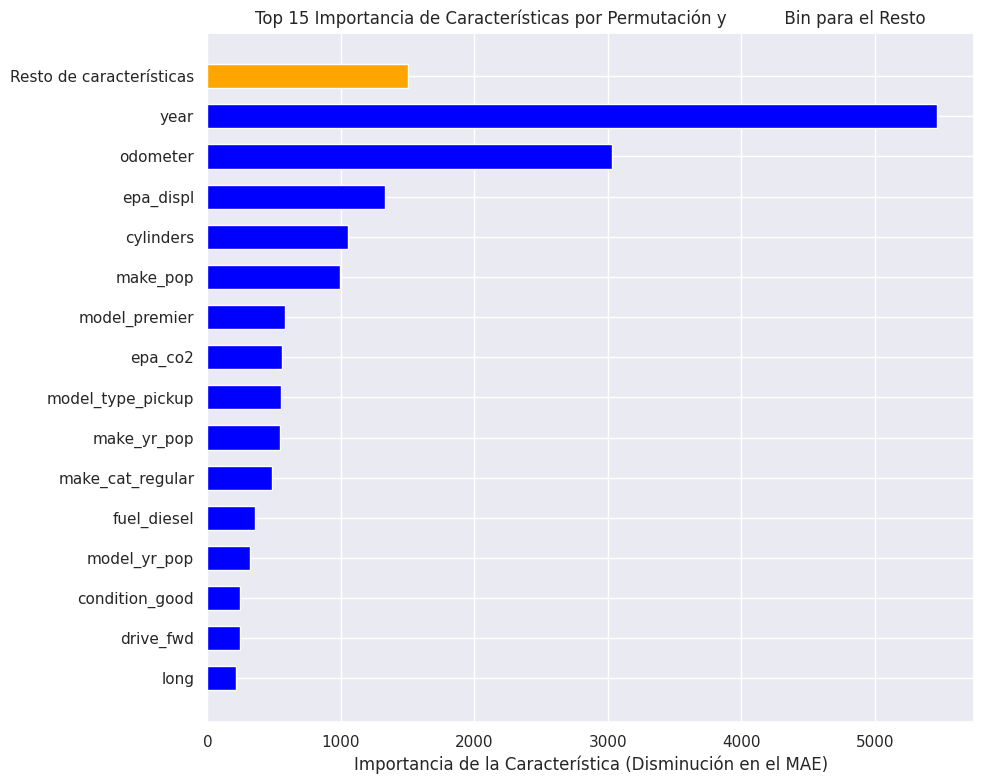

In [25]:
import matplotlib.pyplot as plt

# Asumiendo que 'cb_perm_imp' es el objeto devuelto por 'permutation_importance'
# y 'X_samp' es un DataFrame con las columnas correspondientes a las características

# Obtener la importancia media y los índices de las características ordenados por importancia
perm_sorted_idx = cb_perm_imp.importances_mean.argsort()

# Seleccionar las 15 características más importantes
top_n = 15
top_features_indices = perm_sorted_idx[-top_n:]

# Crear el gráfico de barras para las 15 características más importantes
plt.figure(figsize=(10, 8))
plt.barh(range(top_n), cb_perm_imp.importances_mean[top_features_indices],
         color='blue', height=0.6)

# Agregar una barra para el "bin" de todas las demás características
other_importance_mean = cb_perm_imp.importances_mean[perm_sorted_idx[:-top_n]].sum()
plt.barh([top_n], other_importance_mean, color='orange', height=0.6)

# Etiquetas para las 15 características más importantes
plt.yticks(range(top_n + 1), list(X_samp.columns[top_features_indices]) +\
           ['Resto de características'])

plt.xlabel('Importancia de la Característica (Disminución en el MAE)')
plt.title('Top 15 Importancia de Características por Permutación y\
           Bin para el Resto')
plt.tight_layout()
plt.show()


Permutation feature importance can be understood as the average increase in model error when a feature is made irrelevant, along with its interactions with other features. It is relatively fast to compute since models don’t need to be retrained, but its specific value should be taken with a grain of salt because there are some drawbacks to this shuffling technique:
- Shuffling a highly correlated feature with another unshuffled feature may not significantly affect predictive performance, as the unshuffled feature retains some information from the shuffled one. This means it cannot accurately assess the importance of multicollinear features.
- Shuffling can lead to unrealistic observations, like predicting vehicle traffic with weather and ending up with winter temperatures during the summer. This will result in a higher predictive error for a model that has never encountered such examples, overstating the importance scores beyond their actual significance.

Therefore, these importance values are only useful to rank the features and gauge their relative importance against other features in a particular model. We will now explore how Shapley values can help address these issues.

## SHAP Values

- Cooperative game theory: In this context, players form different sets called coalitions, and when they play, they get varying scores known as marginal contributions. The Shapley value is the average of these contributions across multiple simulations.

- In terms of feature importance, players represent features, sets of players symbolize sets of features, and marginal contribution is related to a decrease in predictive error.

This approach may seem similar to permutation feature importance, but its focus on feature combinations rather than individual features helps tackle the multicollinear issue. Moreover, the values obtained through this method satisfy several favorable mathematical properties, such as:

- Additivity: the sum of the parts adds to the total value
- Symmetry: consistent values for equal contributions
- Efficiency: equal to the difference between the prediction and expected value
- Dummy: a value of zero for features with no impact on the outcome


In practice, this method demands substantial computational resources. For instance, five features yield possible coalitions, while 15 features result in 32,768. Therefore, most Shapley implementations use shortcuts like Monte Carlo sampling or leveraging the model’s intrinsic parameters (which makes them model-specific). The SHAP library employs various strategies to reduce computational load without sacrificing Shapley properties too much.

#### Comprehensive Explanations with the KernelExplainer

> Within SHAP, the most prevalent model-agnostic approach is KernelExplainer, which is based on Local Interpretable Model-agnostic Explanations (LIME). Don’t fret if you don’t understand the specifics since we will cover it in detail in Chapter 5, Local Model-Agnostic Interpretation Methods. To cut down on computation, it employs sample coalitions. In addition, it follows the same procedures as LIME, such as fitting weighted linear models, but employs Shapley sample coalitions and a different kernel that returns SHAP values as coefficients.

KernelExplainer can be initialized with a kmeans background sample of the training dataset (X_train_summary), which helps it define the kernels. It can be still slow. Therefore, it’s better not to use large datasets to compute the shap_values. Instead, in the following code, we are using only 2% of the test dataset (X_test_sample)

In [26]:
%%time
rf_fn = lambda x: rf_mdl.predict(x)
X_train_summary = shap.kmeans(X_train.to_numpy(), 50)
X_test_sample = X_test.sample(frac=0.02)

rf_kernel_explainer = shap.KernelExplainer(rf_fn, X_train_summary)
rf_shap_values = rf_kernel_explainer.shap_values(X_test_sample.to_numpy(),\
                                                 nsamples=100)

  0%|          | 0/1280 [00:00<?, ?it/s]

CPU times: user 9min 33s, sys: 27.5 s, total: 10min 1s
Wall time: 8min 32s


In [27]:
print( rf_shap_values.shape)

(1280, 52)


Note that it’s two dimensions! There’s one SHAP value per observation x feature. For this reason, SHAP values can be used for both global and local interpretation. Put a pin in that!

#### Faster Explanations with TreeExplainer

> TreeExplainer was designed to efficiently estimate SHAP values for tree-based models such as XGBoost, Random Forest, and CART decision trees. It can allocate non-zero values to non-influential non-influential features because it employs the conditional expectation value function rather than marginal expectation, violating the Shapley dummy property. This can have consequences when features are collinear, potentially making explanations less reliable. However, it adheres to other properties.

In [28]:
%%time
cb_tree_explainer = shap.TreeExplainer(cb_mdl)
cb_shap_values = cb_tree_explainer.shap_values(X_test)

CPU times: user 39.6 s, sys: 1.16 s, total: 40.7 s
Wall time: 26.3 s


In [29]:
print( cb_shap_values.shape)

(64017, 52)


> For feature importance values, we can collapse two dimensions into one. All we need to do is average the absolute value per feature like this:


In [30]:
cb_shap_imp = np.mean(np.abs(cb_shap_values),0)

In [31]:
rf_shap_imp = np.mean(np.abs(rf_shap_values),0)

In [32]:
shap_imp_df = pd.DataFrame({'feature':X_train.columns, 'cb_shap_imp':cb_shap_imp,\
                            'rf_shap_imp':rf_shap_imp})
shap_imp_df = shap_imp_df.sort_values('cb_shap_imp', ascending=False)
shap_imp_df.style.format('{:.4f}', subset=['cb_shap_imp', 'rf_shap_imp']).\
                bar(subset=['cb_shap_imp', 'rf_shap_imp'], color='#4EF', width=60)

,feature,cb_shap_imp,rf_shap_imp
4,year,5374.6635,5738.7776
7,odometer,3691.2966,2859.9585
11,epa_displ,1347.3157,1835.7228
9,cylinders,1125.1109,798.6064
3,model_premier,1123.7732,636.6388
2,make_pop,865.3036,385.6415
31,model_type_pickup,861.0232,652.0865
44,drive_fwd,837.2566,271.9131
24,make_cat_regular,767.6872,401.9973
15,fuel_diesel,676.5713,405.2332


## Visualize Global explanations

> Previously, we generated the SHAP values using shap.TreeExplainer and shap.KernelExplainer. This time, we will use SHAP’s newer interface, which simplifies the process by saving SHAP values and corresponding data in a single object and much more! Instead of explicitly defining the type of explainer, you initialize it with shap.Explainer( model), which returns the callable object. Then, you load your test dataset (X_test) into the callable Explainer, and it returns an Explanation object:



> In case you are wondering, how did it know what kind of explainer to create? Glad you asked! There’s an optional parameter called algorithm in the initialization function, and you can explicitly define tree, linear, additive, kernel, and others. But by default, it is set to auto, which means it will guess which kind of explainer is needed for the model. In this case, CatBoost is a tree ensemble, so tree is what makes sense. We can easily check that SHAP chose the right explainer with cb_explainer.[ dict]{ custom-style =" P - Italics"}[ or ]print( type( cb_explainer))

In [33]:
%%time
cb_explainer = shap.Explainer(cb_mdl)
cb_shap = cb_explainer(X_test)

CPU times: user 36.9 s, sys: 458 ms, total: 37.4 s
Wall time: 22.6 s


In [34]:
print(type(cb_explainer))

<class 'shap.explainers._tree.TreeExplainer'>


In [35]:
print("Values dimensions: %s" % (cb_shap.values.shape,))
print("Data dimensions:   %s" % (cb_shap.data.shape,))

Values dimensions: (64017, 52)
Data dimensions:   (64017, 52)


### SHAP Bar Plot

> Let’s start with the most straightforward global explanation visualizations we can do, which is feature importance. You can do this with a bar chart (shap.plots.bar). All it needs is the explanation object (cb_shap), but by default, it will only display 10 bars. Fortunately, we can change this with max_display:


In [36]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 64017 entries, 7316411289 to 7315416877
Data columns (total 52 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   lat                              64017 non-null  float64
 1   long                             64017 non-null  float64
 2   make_pop                         64017 non-null  float64
 3   model_premier                    64017 non-null  int64  
 4   year                             64017 non-null  int64  
 5   make_yr_pop                      64017 non-null  float64
 6   model_yr_pop                     64017 non-null  float64
 7   odometer                         64017 non-null  float64
 8   auto_trans                       64017 non-null  int64  
 9   cylinders                        64017 non-null  int64  
 10  epa_co2                          64017 non-null  float64
 11  epa_displ                        64017 non-null  float64
 12  zip_

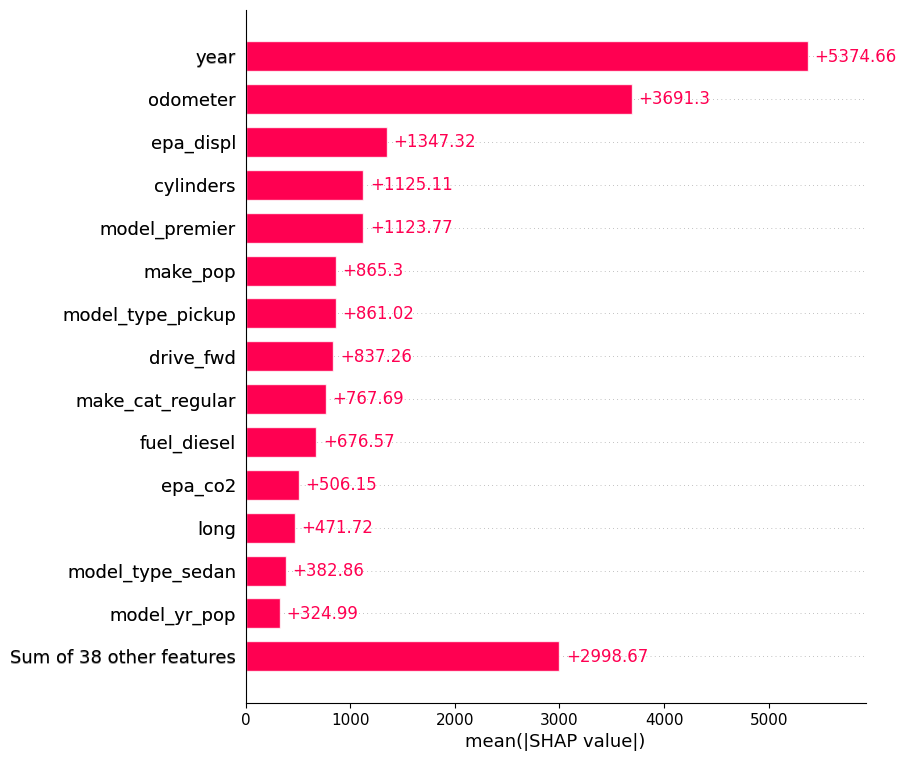

In [37]:
sns.reset_orig()
shap.plots.bar(cb_shap, max_display=15)

> SHAP feature importance offers considerable flexibility since it is simply the average of the absolute value of SHAP values for each feature. With the granularity of SHAP values, you can dissect them in the same way as the test dataset to obtain insights across various dimensions. This reveals more about feature importance than a single average for each feature.

> For example, you can compare feature importance across different groups. Suppose we want to explore how feature importance differs between year cohorts.


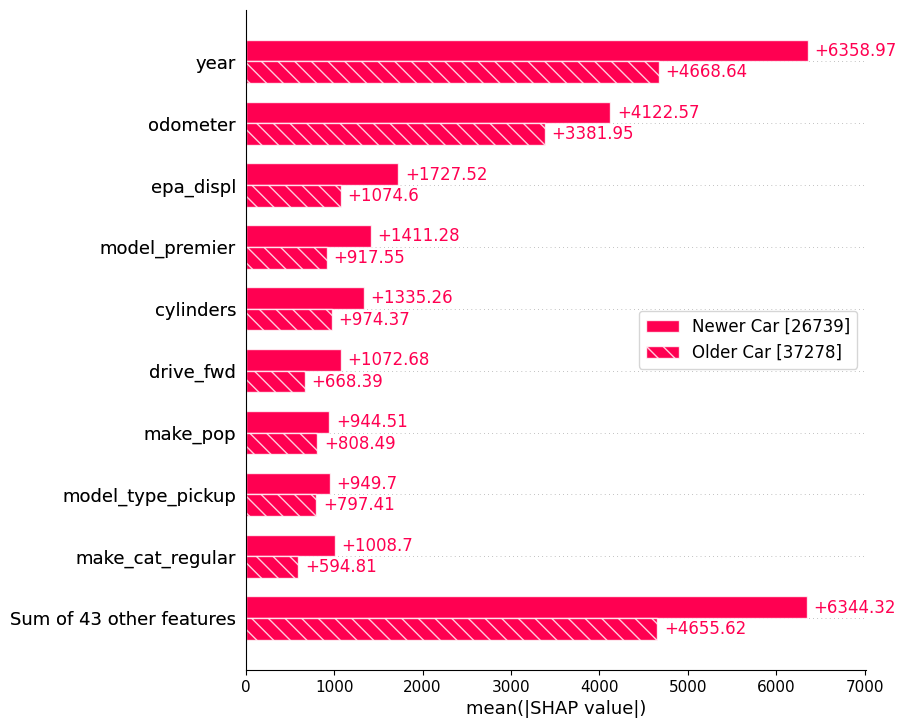

In [38]:
yr_cohort = np.where(X_test.year > 2014,\
                     "Newer Car", "Older Car")

shap.plots.bar(cb_shap.cohorts(yr_cohort).abs.mean(0))

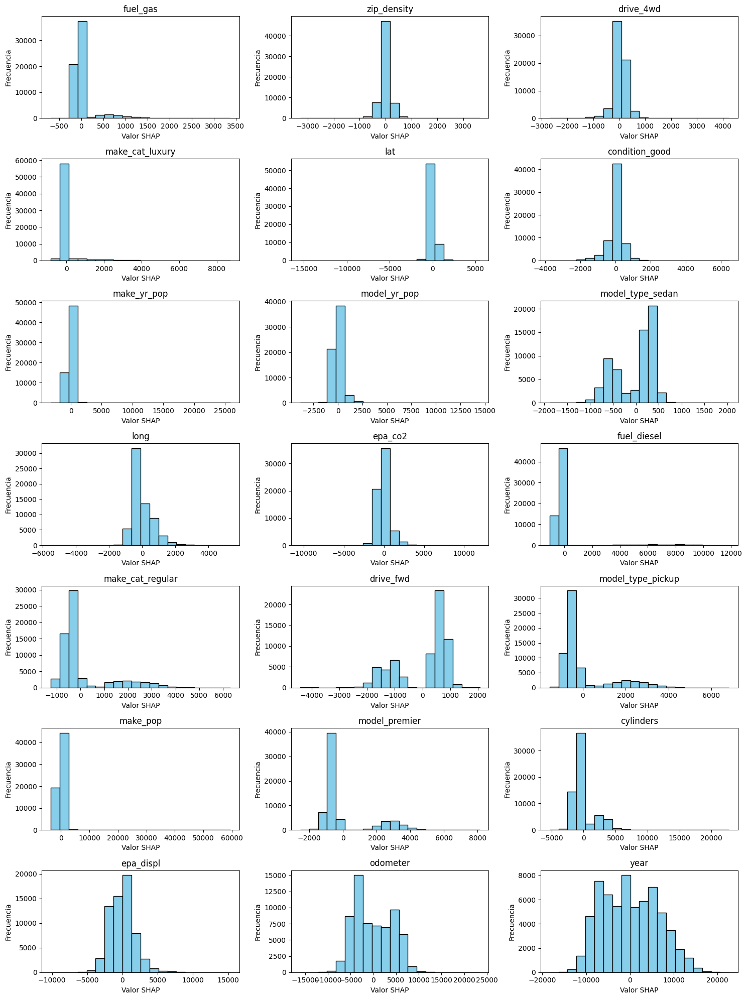

In [67]:
import matplotlib.pyplot as plt

# Asumiendo que X_train es tu conjunto de entrenamiento y tiene los nombres de las características
feature_names = X_train.columns

# Obtenemos los valores SHAP del objeto cb_shap
# Si cb_shap es un Explanation object de SHAP, accedemos a los valores con .values
cb_shap_values = cb_shap.values

# Calculamos la importancia media (media del valor absoluto de los valores SHAP) para cada característica
shap_importance = np.abs(cb_shap_values).mean(axis=0)
# Obtenemos los índices de las 21 características más importantes ordenados por importancia
top_indices = np.argsort(shap_importance)[-21:]

# Creamos una figura con subplots
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(15, 20)) # Ajustar el tamaño según sea necesario
axes = axes.flatten()  # Aplanamos el array de ejes para facilitar su uso en un bucle

# Iteramos sobre las 21 características más importantes y creamos un histograma para cada una
for i, ax in enumerate(axes):
    if i < len(top_indices):
        idx = top_indices[i]
        ax.hist(cb_shap_values[:, idx], bins=20, color='skyblue', edgecolor='black')
        ax.set_title(feature_names[idx])
        ax.set_xlabel('Valor SHAP')
        ax.set_ylabel('Frecuencia')
    else:
        # Ocultamos los ejes adicionales si no hay más características para mostrar
        fig.delaxes(ax)

plt.tight_layout()
plt.show()


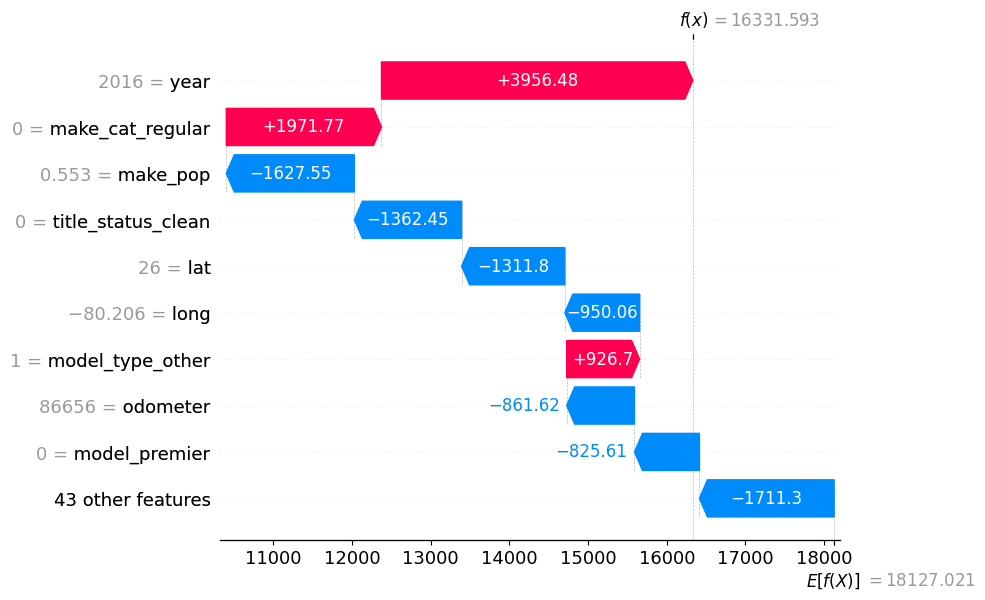

In [40]:
shap.plots.waterfall(cb_shap[0])

In [41]:
y_train.mean()

18127.092357119054

### SHAP Beeswarm Plot

> Bar charts can obscure some aspects of how features affect model outcomes. Not only do different feature values have varying impacts, but their distribution across all observations can also exhibit considerable variation. The beeswarm plot aims to provide more insight by using dots to represent each observation for every individual feature, even though features are ordered by global feature importance:
- Dots are color-coded based on their position in the range of low to high values for each feature.
- Dots are arranged horizontally according to their impact on the outcome, centered on the line where SHAP value = 0, with negative impacts on the left and positive impacts on the right.
- Dots accumulate vertically, creating a histogram-like visualization to display the number of observations influencing the outcome at every impact level for each feature.

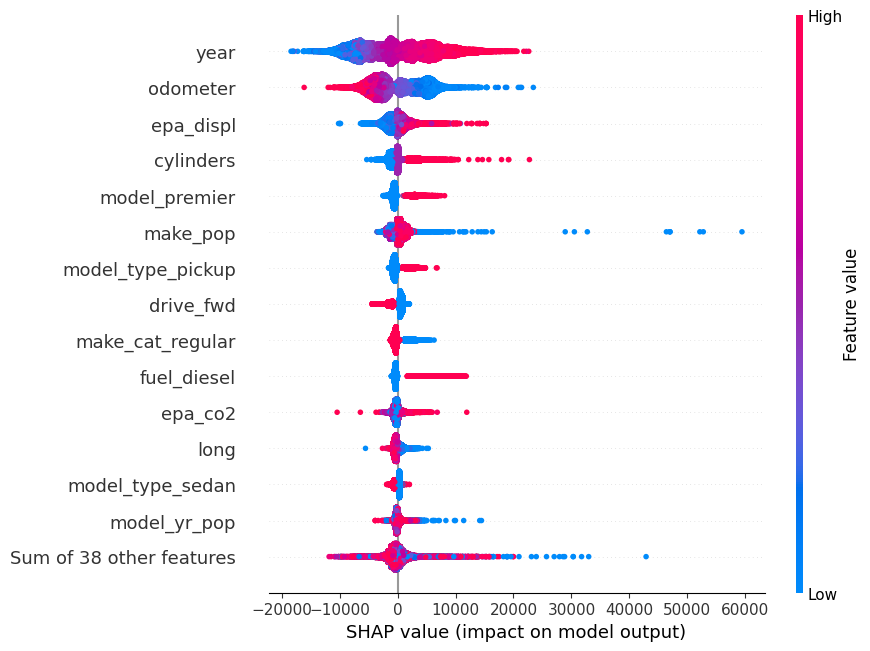

In [42]:
shap.plots.beeswarm(cb_shap, max_display=15)

> Figure  can be read as follows:
 The most important feature (of the 15) from top to bottom is year and the least is longitude (long).

 > It should match the same order in the bar chart or if you take the average absolute values of the SHAP values across every feature.
 **Low values for year negatively impact the model outcome, while high values impact it positively**. There’s a nice clean gradient in between, suggesting an increasing monotonic relationship between year and the predicted price. That is, the higher the year, the higher the price according to the CatBoost model.

> **odometer has a negative or negligible impact on a sizable portion of the observations**. However, it has a long tail of observations for which it has a sizable impact. You can tell this by looking at the density depicted vertically.

> If you scan the rest of the plot looking for other continuous features, you won’t find such a clean gradient anywhere else as you did for year and odometer but you’ll find some trends like higher values of make_yr_pop and model_yr_pop having mostly a negative impact.

> For binary features, it is easy to tell because you only have two colors, and they are sometimes neatly split, as with model_premier, model_type_pickup, drive_fwd, make_cat_regular, and fuel_diesel, demonstrating how a certain kind of vehicle might be a tell-tale sign for the model whether it is high priced or not. In this case, a pick-up model increases the price, whereas a vehicle with a regular make— that is, a brand that is not luxury— decreases the price.

>> While the beeswarm plot offers an excellent summary of many findings, it can sometimes be challenging to interpret, and it doesn’t capture everything. The color-coding is useful for illustrating the relationship between feature values and model output, but what if you want more detail?

**That’s where the partial dependence plot comes in. It’s among the many feature summary explanations that provide a global interpretation method specific to features**



# Feature summary explanations

> This section will cover a number of methods used to visualize how an individual feature impacts the outcome.

### Partial Dependence Plot (PDP)

> Partial Dependence Plots (PDPs) display a feature’s relationship with the outcome according to the model. In essence, the PDP illustrates the marginal effect of a feature on the model’s predicted output across all possible values of that feature.
> The calculation involves two steps:
1. Initially, conduct a simulation where the feature value for each observation is altered to a range of different values, and predict the model using those values. For example, if the year varies between 1984 and 2022, create copies of each observation with year values ranging between these two numbers. Then, run the model using these values. **This first step can be plotted as the Individual Conditional Expectation (ICE) plot**, with simulated values for year on the X-axis and the model output on the Y-axis, and one line per simulated observation.
2. In the second step, simply average the ICE lines to obtain a general trend line. This line represents the PDP!

> PDPs can be created using scikit-learn but these only work well with scikit-learn models. They also can be generated with the SHAP library, as well as another library called PDPBox.





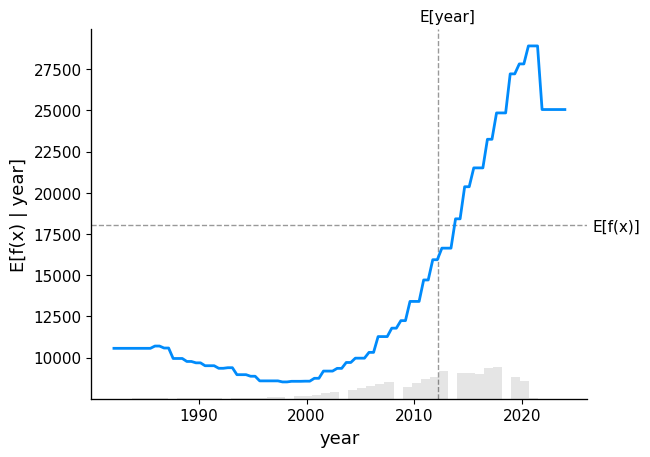

In [43]:
shap.plots.partial_dependence("year", cb_mdl.predict, X_test,\
                              ice=False, model_expected_value=True,\
                              feature_expected_value=True)

> As you can appreciate in Figure , there’s an upward trend for year. This finding shouldn’t be surprising considering the neat gradient in Figure 4.8 for year. With the histogram, you can tell the bulk of observations have values for year over 2011, which is where it starts to have an above-verage impact on the model. This makes sense once you compare the location of the histogram to the location of the bulge in the beeswarm plot

### PDP box / PDP isolate

> With PDPBox, we will make several variations of PDP plots. This library separates the potentially time-consuming process of making the simulations with the PDPIsolate function from the plotting with the plot function. We will only have to run PDPIsolate once but plot three times.

> For the first plot, we use plot_pts_dist = True to display a rug. The rug is a more concise way of conveying the distribution than the histogram.

> For the second one, we use plot_lines = True to plot the ICE lines, but we can only plot a fraction of them, so frac_to_plot = 0.01 randomly selects 1% of them.

> For the third one, instead of showing a rug, we can construct the X-axis with quantiles (to_bins = True)

In [44]:
pdp_single_feature = pdp.PDPIsolate(
    model=cb_mdl, df=X_test, model_features=X_test.columns, feature='year',\
    feature_name='year', n_classes=0, n_jobs=-1
)



obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

> **Rug PDP plot**  / Intevalo de confianza / Distribución de los casos

In [64]:
fig, axes = pdp_single_feature.plot(plot_pts_dist=True)
fig.show()

> **Plot ICE lines**

In [65]:
fig, axes = pdp_single_feature.plot(plot_pts_dist=True, plot_lines=True,\
                                    frac_to_plot=0.01)
fig.show()

> **Plot ICE lines with quantiles**

In [47]:
fig, axes = pdp_single_feature.plot(to_bins=True, plot_lines=True,\
                                    frac_to_plot=0.01, show_percentile=True)
fig.show()

> The ICE lines enrich the PDP plots by showing the potential for variance. The last plot in Figure 4.10 also shows how, even though rugs or histograms are useful guides, organizing the axis in quantiles better helps visualize distribution. In this case, two-thirds of year is distributed before 2017. And the two decades between 1984 and 2005 only account for 11%. It’s only fair they get a corresponding portion of the plot.


> We can now create a few lists we will use to iterate across different kinds of features, whether continuous (cont_feature_l), binary (bin_feature_l), or categorical (cat_feature_l):


In [48]:
cont_feature_l = ['year', 'odometer', 'cylinders', 'epa_displ',\
                  'make_pop', 'make_yr_pop', 'model_yr_pop']

make_cat_feature_l = ['make_cat_obsolete', 'make_cat_regular', 'make_cat_premium',\
                      'make_cat_luxury', 'make_cat_luxury_sports']

bin_feature_l = ['model_premier', 'auto_trans']

cat_feature_l = make_cat_feature_l + bin_feature_l

#### Partial dependecy Plots for several features

> To quickly get a sense of what PDPs look like for each feature, we can iterate across one of the lists of features producing PDP plots for each one.

> **PDP / ICE plots for continuous features**

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

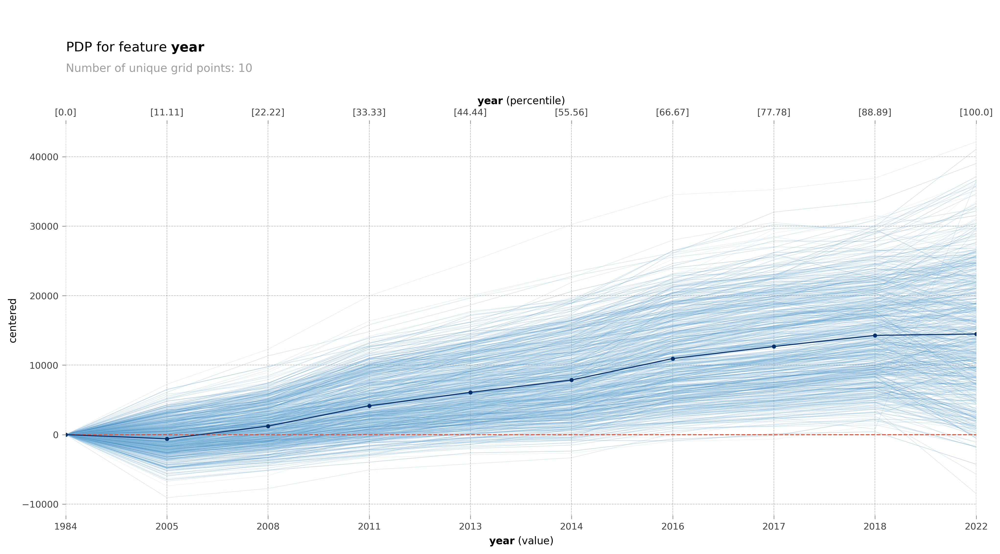

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

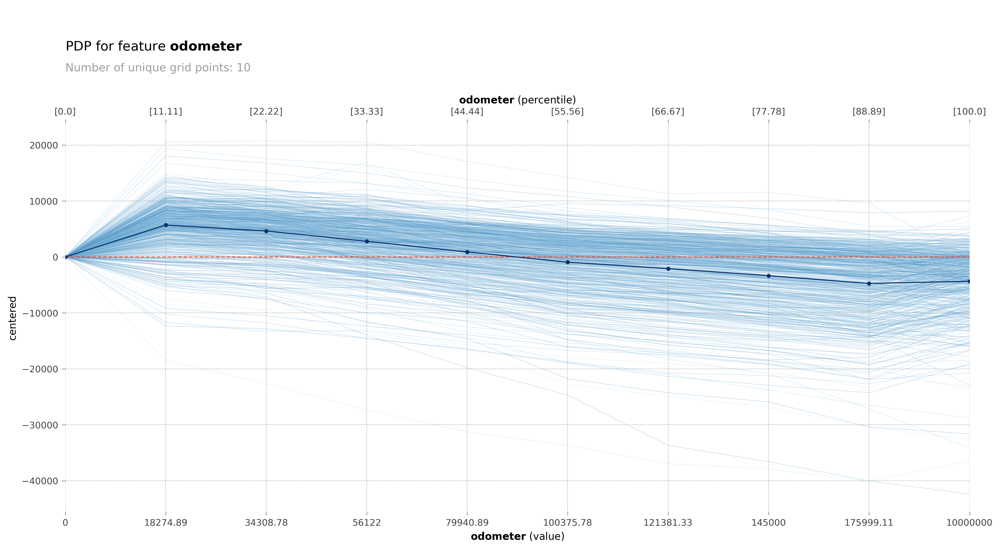

obtain pred_func from the provided model.


  0%|          | 0/5 [00:00<?, ?it/s]

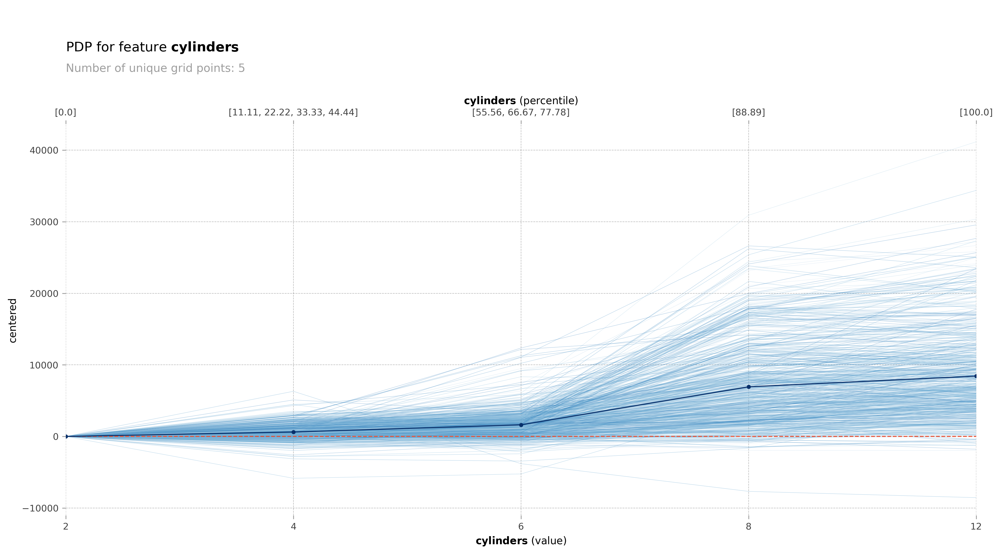

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

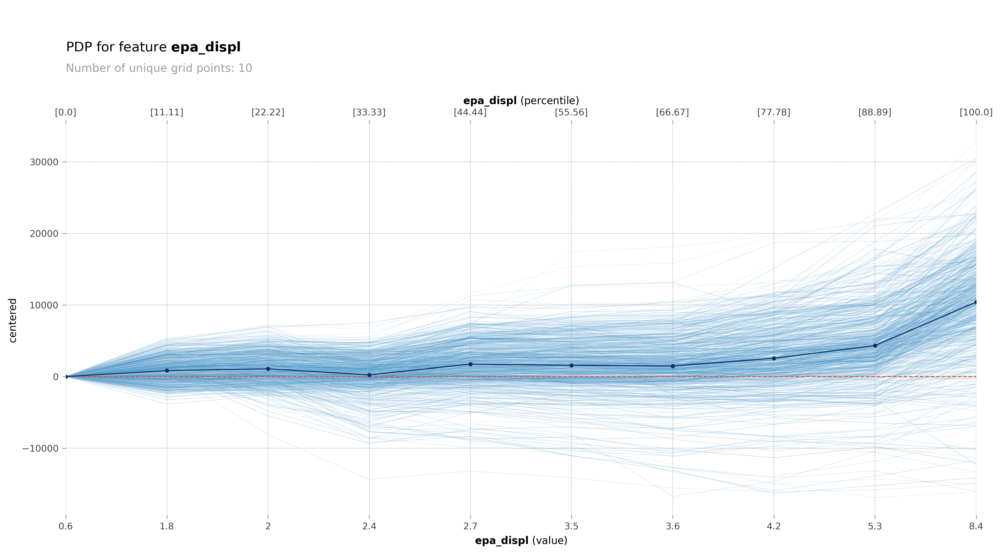

obtain pred_func from the provided model.


  0%|          | 0/9 [00:00<?, ?it/s]

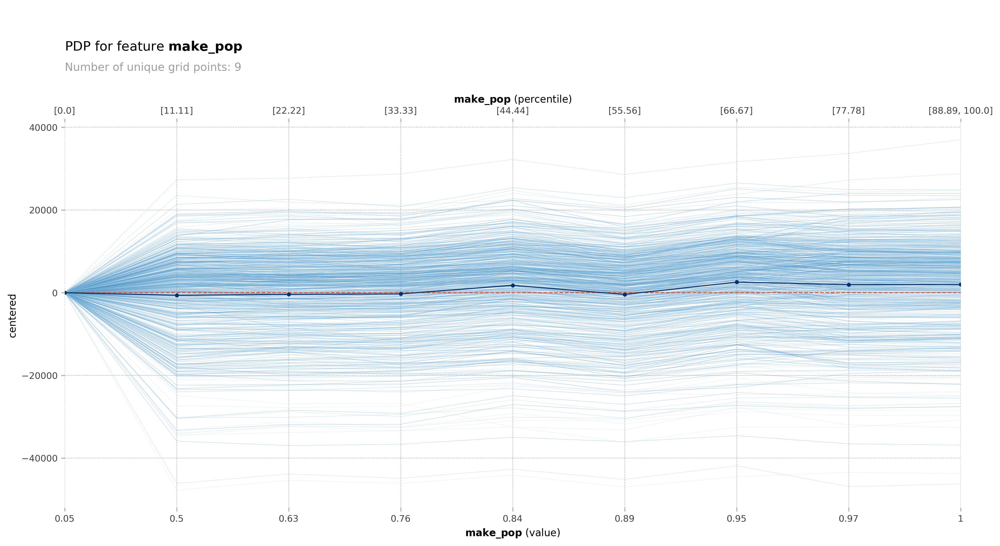

obtain pred_func from the provided model.


  0%|          | 0/9 [00:00<?, ?it/s]

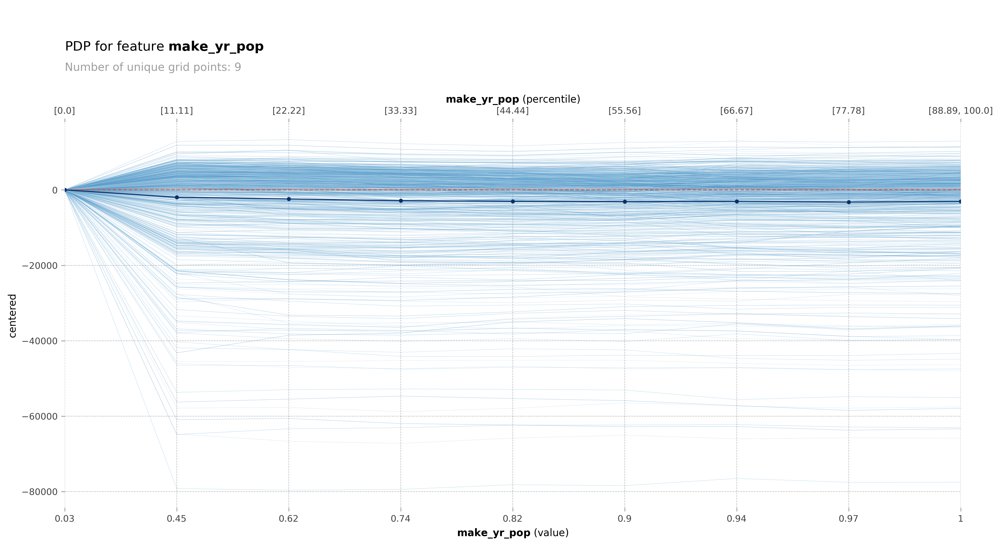

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

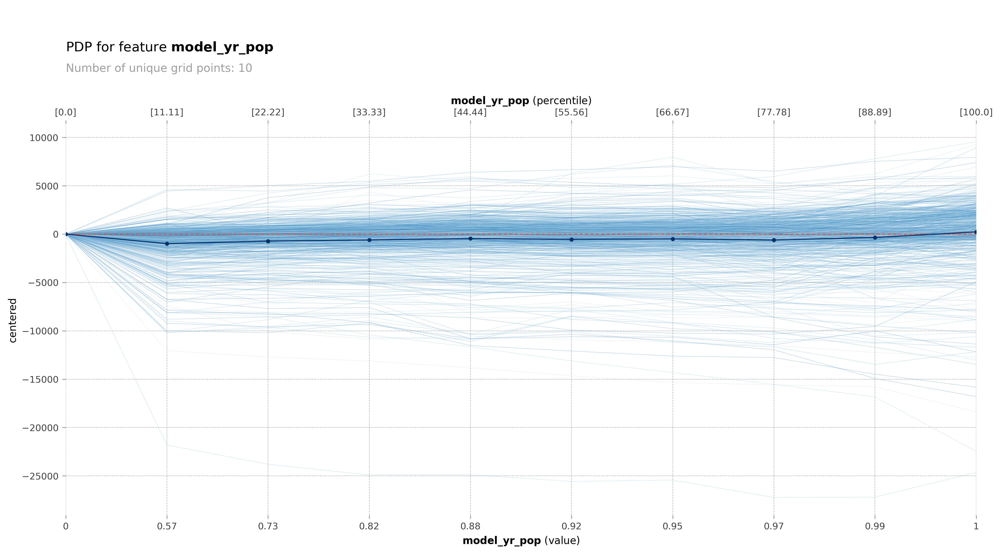

In [49]:
for feature in cont_feature_l:
    pdp_single_feature = pdp.PDPIsolate(
        model=cb_mdl, df=X_test, model_features=X_test.columns,\
        feature=feature, feature_name=feature, n_classes=0, n_jobs=-1)
    fig, axes = pdp_single_feature.plot(to_bins=True, plot_lines=True,\
                             frac_to_plot=0.01, show_percentile=True,\
                             engine='matplotlib')
    plt.show()

> The beeswarm plot in Figure 4.8 shows that a low value of odometer correlates with the model outputting a higher price. In Figure 4.11, it depicts how it’s mostly monotonically decreasing except in the extremes. It’s interesting that there are odometer values of zero and ten million in the extremes. While it makes sense that the model learned that odometer made no difference in prices when it’s zero, a value of ten million is an anomaly, and for this reason, you can tell that the ICE lines are going in different directions because the model is not sure what to make of such a value. We must also keep in mind that ICE plots, and thus PDPs, are generated with simulations that may create examples that wouldn’t exist in real life, such as a brand-new car with an extremely high odometer value.

> **PDP / ICE for make_cat Features / One Plot for one-hot-encoded category**

> If you replace cont_feature_l with make_cat_feature_l and re-run the previous snippet, you will realize that some make categories correlate positively while others negatively with the outcome. This finding shouldn’t be surprising considering some make categories, such as “luxury” are indicative of a high price and others of a lower one. That being said, make_cat is a categorical feature that was one-hot encoded, so it’s not natural to create PDP plots as if each category were an independent binary feature.

Serg Masís. 9781803235424 (Kindle Locations 3228-3232). Kindle Edition.

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

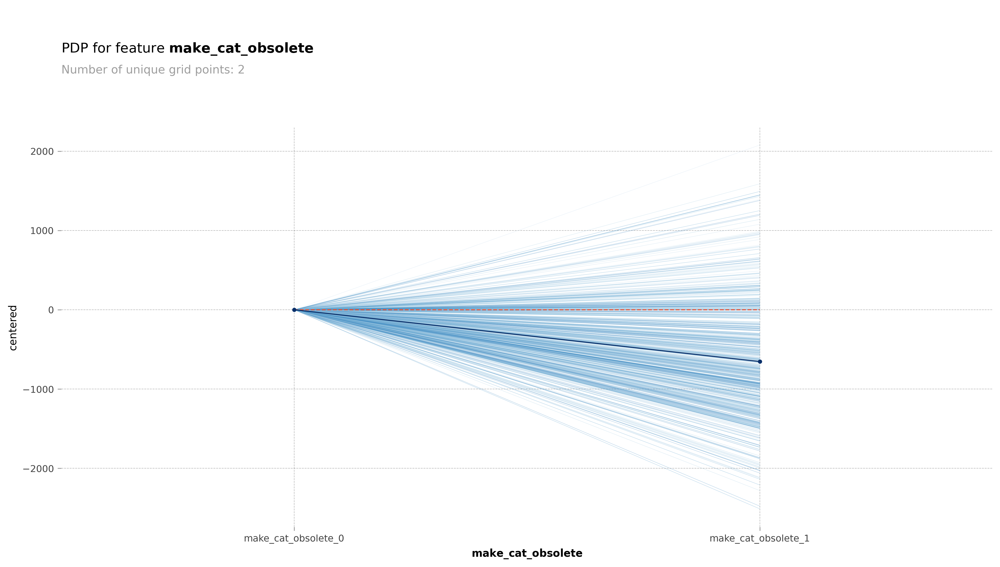

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

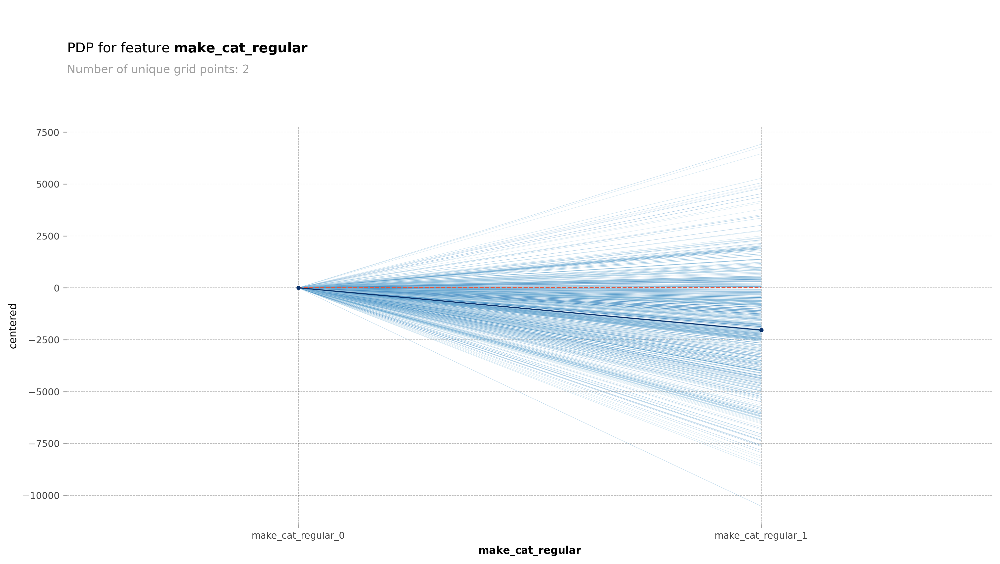

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

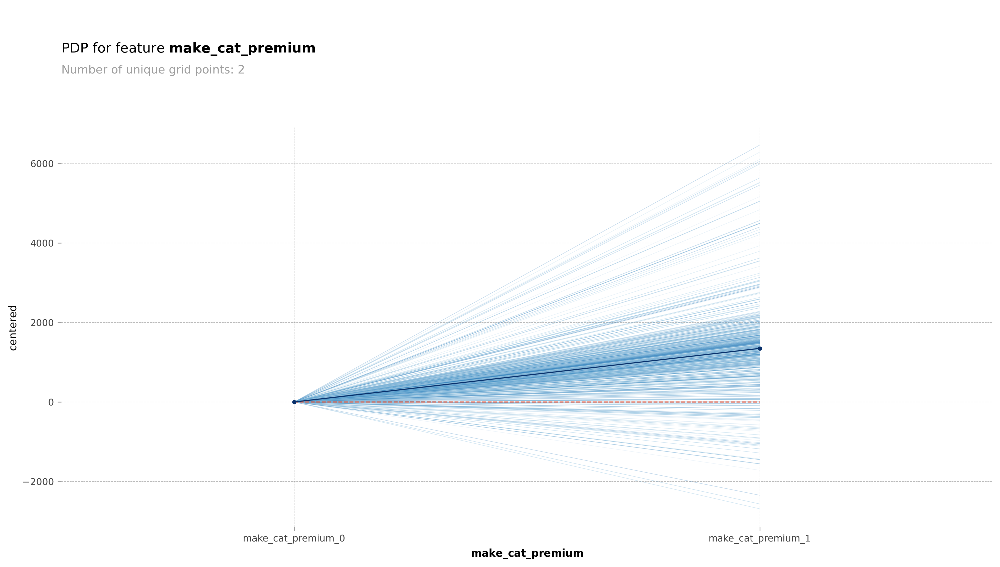

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

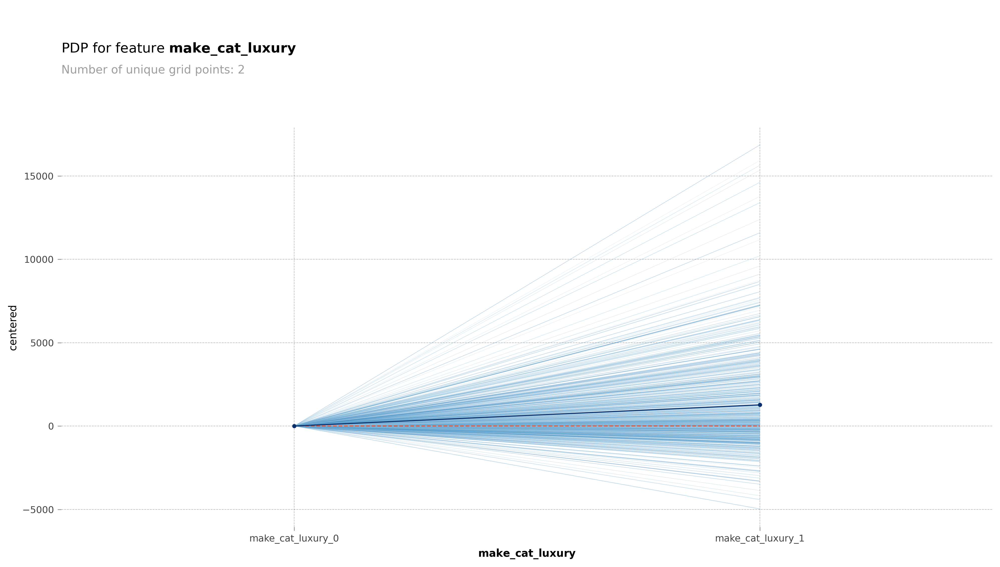

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

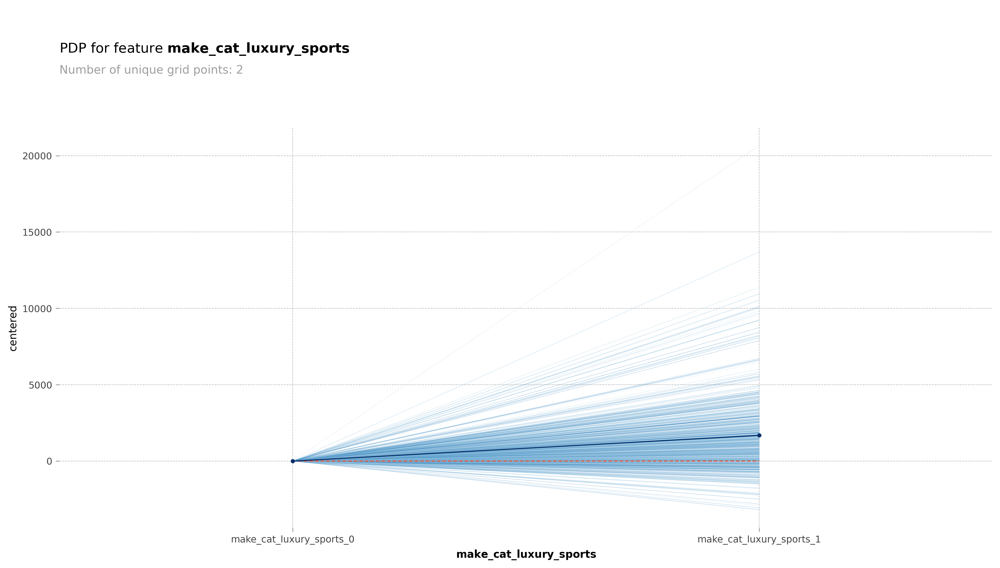

In [50]:
for feature in make_cat_feature_l:
    pdp_single_feature = pdp.PDPIsolate(
        model=cb_mdl, df=X_test, model_features=X_test.columns,\
        feature=feature, feature_name=feature, n_classes=0, n_jobs=-1)
    fig, axes = pdp_single_feature.plot(to_bins=True, plot_lines=True,\
                             frac_to_plot=0.01, show_percentile=True,\
                             engine='matplotlib')
    plt.show()

 > **PDP / ICE for make_cat Features / All possible values**

Fortunately, you can create a PDP with each one-hot encoded category side by side. All you need to do is plug in the list of product-type features in the feature attribute.


In [51]:
pdp_multi_feature = pdp.PDPIsolate(
    model=cb_mdl, df=X_test, model_features=X_test.columns,\
    feature=make_cat_feature_l, feature_name="make_cat",\
    n_classes=0, n_jobs=-1)

obtain pred_func from the provided model.


  0%|          | 0/5 [00:00<?, ?it/s]

In [63]:
fig, axes = pdp_multi_feature.plot(plot_lines=True, plot_pts_dist=True,\
                         frac_to_plot=0.05, show_percentile=True)
fig.show()

#### Prediction Distribution
> PDPBox also has a “predict plot,” which can help provide context by showing prediction distribution across feature values. PredictPlot is easy to plot, having many of the same attributes as the plot.

In [53]:
predict_plot = info_plots.PredictPlot(
    model=cb_mdl, df=X_test, model_features=X_test.columns, feature=make_cat_feature_l,\
    feature_name="make_cat", n_classes=0)

fig, _, _ = predict_plot.plot()
fig.show()

obtain pred_func from the provided model.


> The PDP for make_cat in Figure 4.12 shows the tendency of “luxury” and “premium” categories to lead to higher prices but only by about 3,000 dollars on average with a lot of variance depicted in the ICE lines. However, remember what was said about simulations not being necessarily representative of real-life scenarios? If we compare the PDP to the box and whiskers in the actual predictions in Figure 4.12, we can tell that the difference in average prediction between regular and any of the “luxury” and “premium” categories is at least seven thousand dollars. Of course, the average doesn’t tell the whole story because even a premium car with too much mileage or that’s very old might cost less than a regular vehicle. The price depends on many factors besides the reputation of the make. Of course, just judging by how the boxes and whiskers align in Figure 4.12, “luxury sports” and “obsolete” categories are stronger indications of higher and lower prices, respectively.

# ALTERNATIVES TO PDPs (SHAP Scatter Plots and Ale Plots)

PDPs are often straightforward to interpret and relatively quick to generate. However, the simulation strategy it employs doesn’t account for feature distribution and heavily relies on the assumption of feature independence, which can lead to counterintuitive examples. We will now explore two alternatives. SHAP scatter plot and ALE Plots
.

### SHAP Scatter Plot

> SHAP values are available for every data point, enabling you to plot them against feature values, resulting in a PDP-like visualization with model impact (SHAP values) on the y-axis and feature values on the x-axis. Being a similar concept, the SHAP library initially called this a dependence_plot, but now it’s referred to as a scatter plot. Despite the similarities, PDP and SHAP values are calculated differently. Creating a SHAP scatter plot is simple, requiring only the explanation object. Optionally, you can color-code the dots according to another feature to understand potential interactions. You can also clip outliers from the x-axis using percentiles with xmin and xmax attributes and make dots 20% opaque (alpha) to identify sparser areas more easily:

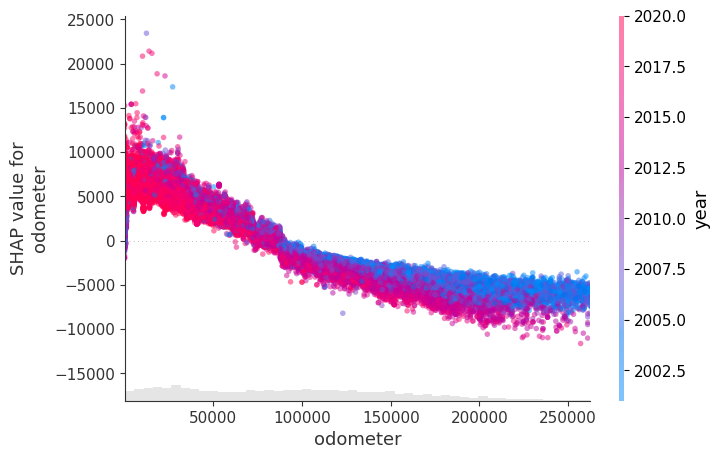

In [54]:
shap.plots.scatter(cb_shap[:,"odometer"], color=cb_shap[:,"year"],\
                   xmin="percentile(1)", xmax="percentile(99)", alpha=0.5)

> The first plot in Figure 4.13 depicts how a higher odometer reading negatively impacts the model outcome. Also, the color coding shows that the SHAP values for higher years are even lower when the odometer reading is over ninety thousand. In other words, an old car with a high odometer reading is expected, but with a new car, it’s a red flag!

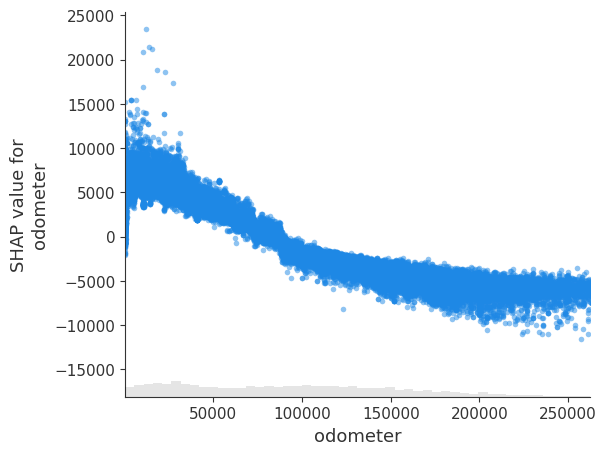

In [55]:
shap.plots.scatter(cb_shap[:,"odometer"],\
                   xmin="percentile(1)", xmax="percentile(99)", alpha=0.5)

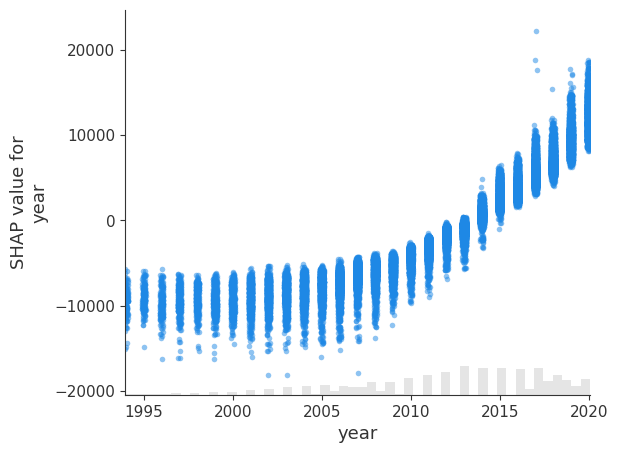

In [57]:
shap.plots.scatter(cb_shap[:,"year"],\
                   xmin="percentile(1)", xmax="percentile(99)", alpha=0.5)

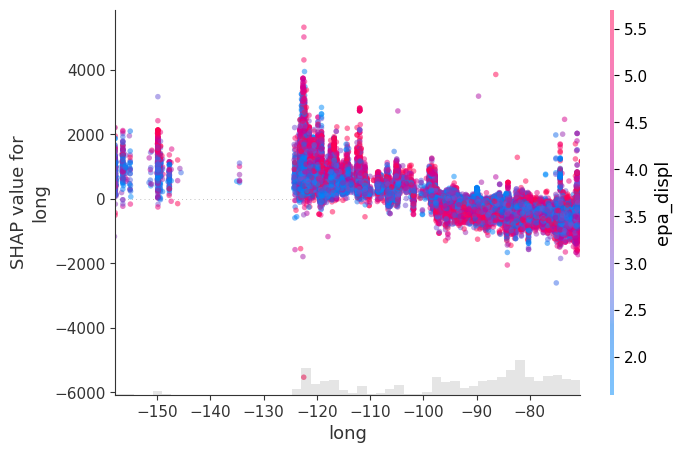

In [58]:
shap.plots.scatter(cb_shap[:,"long"], color=cb_shap[:,"epa_displ"],\
                   xmin="percentile(0.5)", xmax="percentile(99.5)", alpha=0.5,\
                   x_jitter=0.5)

> The second plot in Figure 4.13 is very interesting; it shows how the west coast of the country (at about -120 °) correlates with higher SHAP values and the further east it goes, the lower the SHAP values. Hawaii, Anchorage, and Alaska (at about -150 °) are also higher than the east coast of the United States (at around -75 °). The color coding shows how the more liters displaced of fuel mostly leads to higher SHAP values but it’s not as stark of a difference the further east you go.

> Since there are only two possible values on the x-axis, 0 and 1, what makes sense is to jitter them so that all the dots don’t get plotted on top of each other. For instance, x_jitter = 0.4 means they will be jittered horizontally up to 0.4, or 0.2 on each side of the original value. We can combine this with alpha to ensure that we can appreciate the density:

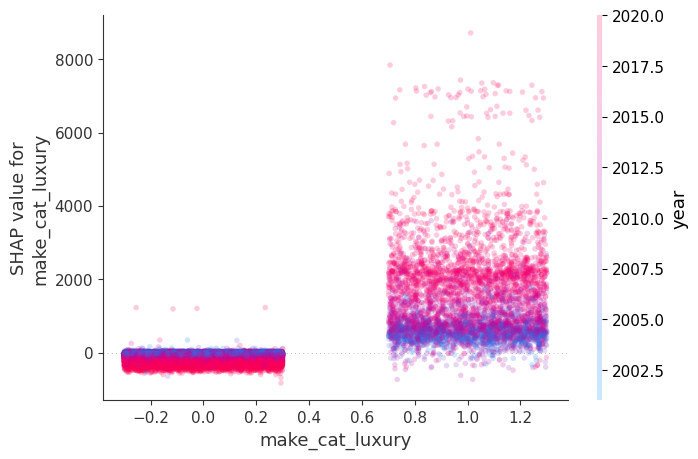

In [59]:
shap.plots.scatter(cb_shap[:,"make_cat_luxury"], color=cb_shap[:,"year"],\
                   x_jitter=0.6, alpha=0.2, hist=False)

> shows that according to the SHAP values, make_cat_fha = 1 positively impacts the model outcome, whereas make_cat_fha = 1 has a mildly negative effect. The color coding suggests that lower years tempers the impact, making it smaller. This makes sense because older luxury cars have depreciated.

While SHAP scatter plots may be an improvement from PDP plots, SHAP’s tree explainers trade fidelity for speed, causing features that have no influence on the model to potentially have a SHAP value above zero. Fidelity refers to the accuracy of an explanation in representing the behavior of the model. **To get higher fidelity, you need to use a method that makes fewer shortcuts in understanding what the model is doing, and even then, some adjustments to parameters like using a greater sample size will increase fidelity too because you are using more data to create the explanations. In this case, the solution is to use KernelExplainer instead because, as we previously discussed, it is more comprehensive**, but it has issues with feature dependence. So there’s no free lunch! Next, we will cover ALE plots as a partial solution to these problems.

### Accumulated Local Effects (ALE) Plots

> ALE plots are advantageous over PDPs because they are unbiased and faster. ALE accounts for data distributions when calculating feature effects, resulting in an unbiased representation. The algorithm divides the feature space into equally sized windows and computes how predictions change within these windows, resulting in the local effects. Summing the effects across all windows makes them accumulated.



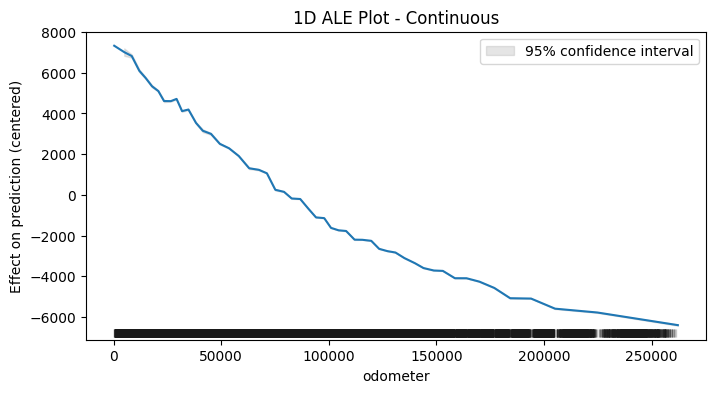

In [60]:
X_test_no_outliers = X_test[(X_test.year.quantile(.01) <= X_test.year) &\
                           (X_test.year <= X_test.year.quantile(.99)) &\
                           (X_test.odometer.quantile(.01) <= X_test.odometer) &\
                           (X_test.odometer <= X_test.odometer.quantile(.99))]

ale_effect = ale(X=X_test_no_outliers, model=cb_mdl, feature=['odometer'],\
                 feature_type='continuous', grid_size=50)
plt.show()

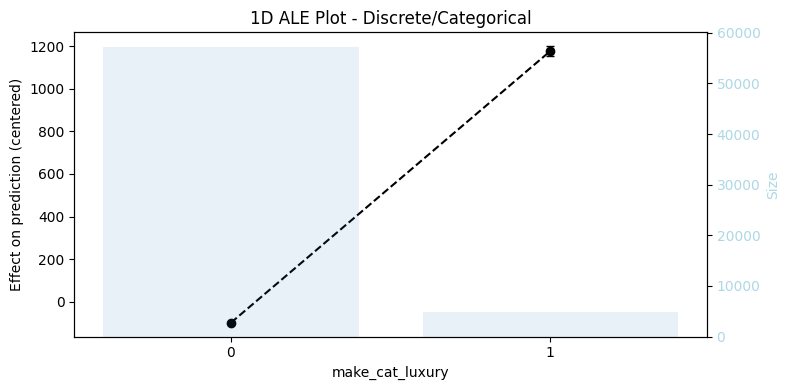

In [61]:
ale_effect = ale(X=X_test_no_outliers, model=cb_mdl, feature=['make_cat_luxury'],\
                 feature_type='discrete')
plt.show()

> The first plot in Figure 4.15 is the ALE plot for odometer. As portrayed in Figure 4.13, the effect on the model goes from positive to negative as the odometer reading increases. However, unlike SHAP, in the ALE plot, it goes negative long before the odometer reaches 90,000. Please note the confidence interval is so thin it’s only visible somewhere under 10,000. The second ALE plot shows a significant positive impact of the “luxury” category on the outcome and that luxury vehicles are not as represented as other ones.

# Feature interactions

Features may not influence predictions independently. For example, as discussed in Chapter 2, Key Concepts of Interpretability, determining obesity based solely on weight isn’t possible. A person’s height or body fat, muscle, and other percentages are needed. Models understand data through correlations, and features are often correlated because they are naturally related, even if they are not linearly related. Interactions are what the model may do with correlated features. For instance, a decision tree may put them in the same branch, or a neural network may arrange its parameters in such a way that it creates interaction effects. This also occurs in our case. Let’s explore this through several feature interaction visualizations.





### SHAP Bar Plot with Clustering

SHAP comes with a hierarchical clustering method (shap.utils.hclust) that allows for the grouping of training features based on the “redundancy” between any given pair of features. This refers to the degree to which they depend on each other, on a scale from complete redundancy (0) to total independence (1). We won’t use the entire dataset for this task because it would take a very long time, so we will use a 10% sample:

In [62]:
X_samp = X.sample(frac=0.1)
y_samp = y.loc[X_samp.index]
clustering = shap.utils.hclust(X_samp, y_samp)

53it [01:15,  1.65s/it]


> We can employ the same bar chart as in Figure 4.6, but this time, we input the clustering and clustering cutoff and voilá! We can visualize which features are most redundant. Our aim is to pinpoint relationships that are less than 0.7 independent (clustering_cutoff):

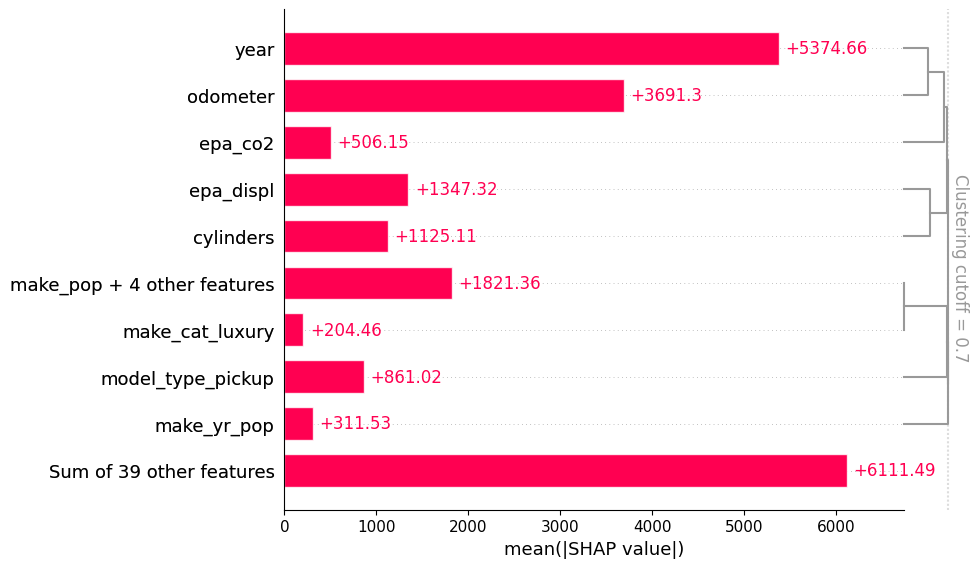

In [85]:
shap.plots.bar(cb_shap, clustering=clustering, clustering_cutoff=0.7)

> The dendrogram on the right in Figure 4.16 reveals which features rely on each other the most and at three tiers. For instance, year is dependent on odometer, and when combined, they both depend on epa_co2, which in turn depends indirectly on a number of features, including the fuel displacement (epa_displ) and cylinders features. Also, please note that all make category features depend on each other but also on the make’s relative popularity (make_pop). This finding makes sense because some categories are overall more popular than others. These insights can serve as a guide for subsequent investigations.

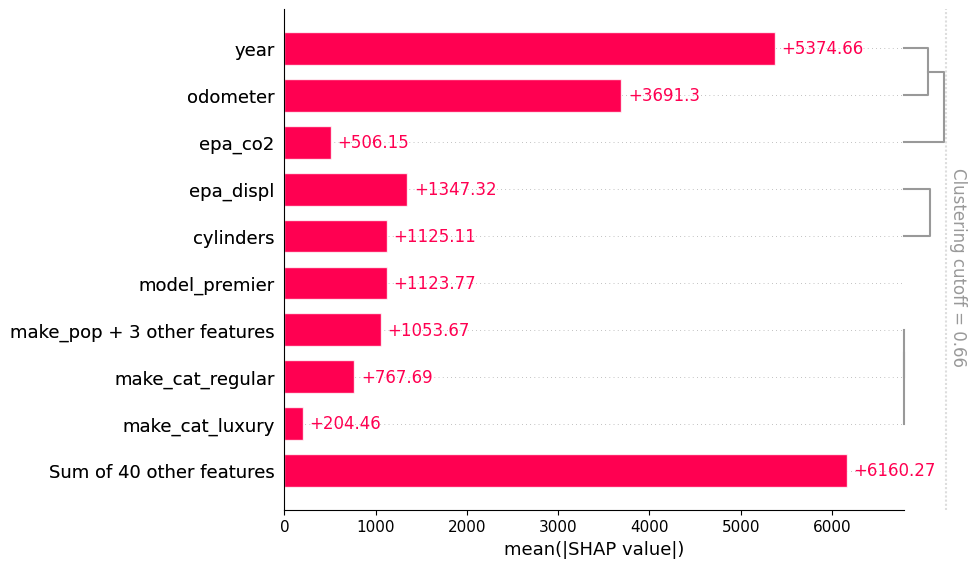

In [84]:
shap.plots.bar(cb_shap, clustering=clustering, clustering_cutoff=0.66)

### 2D Accumulated Local Effects (ALE) Plots

The optimal way to visually inspect the impact of two variables on predictions is through 2D ALE plots, primarily because it’s unbiased when dealing with correlated features. Let’s scrutinize the top features, year and odometer, which also have a clear dependency. We’ll utilize the test dataset minus the outliers so that the plot focuses on the core of the data— that is, the part containing approximately 98% of the data points. This time, instead of a single feature, we’ll insert a list of two features:

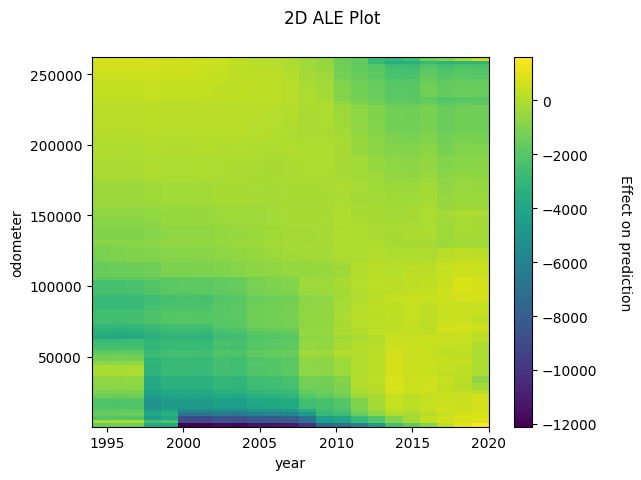

In [89]:
features_l = [ "odometer", "year",]

mpl.rcParams["image.aspect"] = "auto"
ale_effect = ale(X=X_test_no_outliers, model=cb_mdl, feature=features_l,\
                 feature_type='continuous', grid_size=100, include_CI=False)
plt.show()

> As seen in Figure 4.17, except for a slim range of extremely high odometer readings and areas where older cars and low odometer readings overlap, there’s a modest effect for most of the plot. Mostly, they seem to only have a larger negative effect in the corners.

In [63]:
np.set_printoptions(suppress=True)
print(clustering)

[[  2.          21.           0.           2.        ]
 [ 22.          52.           0.           3.        ]
 [ 23.          53.           0.           4.        ]
 [ 24.          54.           0.           5.        ]
 [ 20.          55.           0.           6.        ]
 [  4.           7.           0.38680011   2.        ]
 [  9.          11.           0.4162052    2.        ]
 [ 43.          44.           0.42938936   2.        ]
 [ 15.          17.           0.45512533   2.        ]
 [ 12.          14.           0.52989352   2.        ]
 [  0.           1.           0.56387955   2.        ]
 [ 61.          62.           0.5797441    4.        ]
 [ 13.          63.           0.59420842   5.        ]
 [ 46.          49.           0.59832066   2.        ]
 [ 10.          57.           0.62910491   3.        ]
 [ 58.          66.           0.67684174   5.        ]
 [ 31.          56.           0.68109715   7.        ]
 [ 51.          65.           0.6936273    3.        ]
 [  5.    

> An important point to remember is that SHAP’s clustering distance ranges from redundancy to independence. The issue with highly correlated features is that, at a certain point, they cease depending on each other and become entirely redundant. So, let’s examine how close to redundancy these two features are with the clustering array we created with shap.utils.hclust:

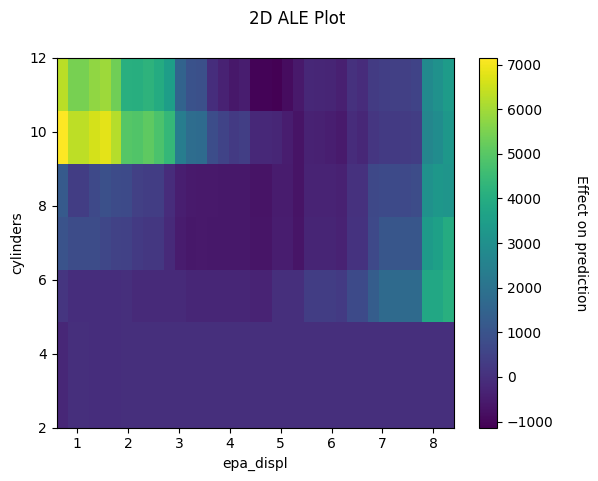

In [90]:
features_l = ["cylinders", "epa_displ"]

ale_effect = ale(X=X_test, model=cb_mdl, feature=features_l,\
                 feature_type='discrete', grid_size=150)
plt.show()

> Figure 4.18 distinctly illustrates higher interaction effects where cylinders is larger than 8 and where epa_displ is under 4. This finding is counterintuitive considering vehicles with a lot of cylinders are unlikely to have low amounts of engine displacement. On the other hand, the higher interaction effects when there are over 4 cylinders and an engine displacement of at least 6 liters make more sense. Please note that there are other factors such as year and model_type that correlate with these two features, but ALE is great at separating the effects of cylinders and epa_displ from other highly correlated features.

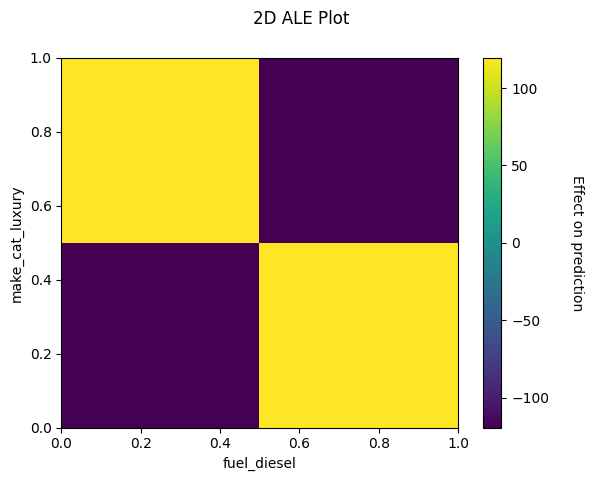

In [91]:
features_l = ["make_cat_luxury", "fuel_diesel"]

ale_effect = ale(X=X_test, model=cb_mdl, feature=features_l,\
                 feature_type='discrete', grid_size=200)
plt.show()

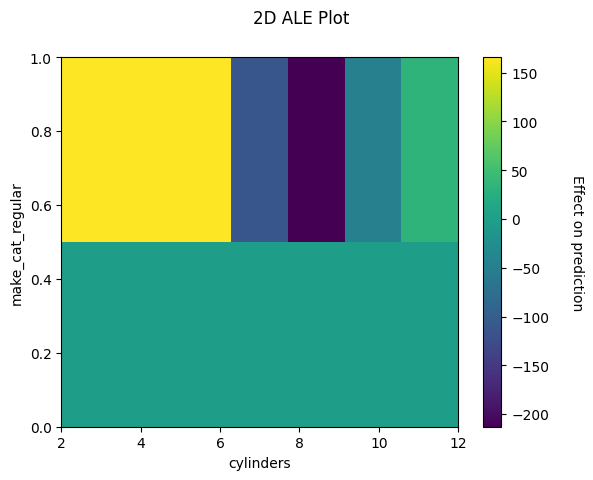

In [92]:
features_l = ["make_cat_regular", "cylinders"]

ale_effect = ale(X=X_test, model=cb_mdl, feature=features_l,\
                 feature_type='discrete', grid_size=200)
plt.show()

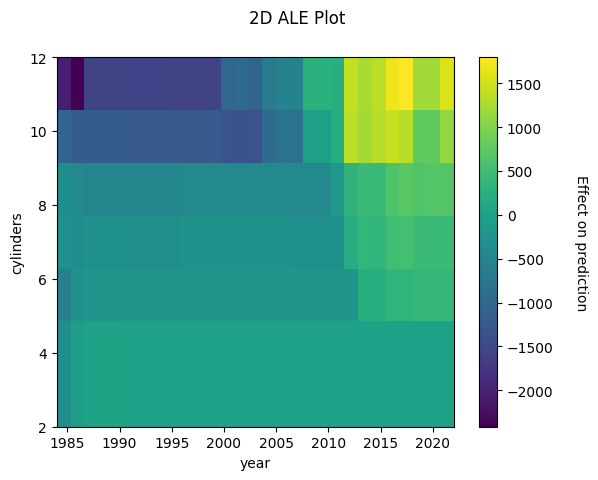

In [93]:
features_l = ["cylinders", "year"]

ale_effect = ale(X=X_test, model=cb_mdl, feature=features_l,\
                 feature_type='discrete', grid_size=200)
plt.show()

### PDP Interactions Plots

> I’m sure you’re wondering: Given the numerous limitations of PDP, when and where should we contemplate using 2D PDP? **Only when a proven relationship exists between two features, but they are not entirely redundant or independent, and ideally, when they perfectly complement each other**. Even then, an ALE plot is advisable as it teases out higher-order effects.

>Nonetheless, for illustrative purposes, we will generate a 2D PDP with long and lat, which are indirectly connected. The code for 2D is very similar to 1D, with the exception that we use PDPInteract instead of PDPIsolate, and then for the plot function, designate the plot_type as contour, but grid could also be used

In [94]:
features_l = ["long", "lat"]

pdp_interaction_feature = pdp.PDPInteract(
    model=cb_mdl, df=X_test, model_features=X_test.columns, features=features_l,\
    feature_names=features_l, n_classes=0, num_grid_points=15, n_jobs=-1
)


obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/225 [00:00<?, ?it/s]

In [96]:
fig, _ = pdp_interaction_feature.plot(
    plot_type='contour', plot_pdp=False)
fig.show()

> Figure 4.19 serves as proof of how the features are related to the outcome: long seems to be responsible for most of the effect, but in some areas, lat seems to make a difference, especially in Alaska in the top-left corner. We can check the reliability of this result with a 2D predict plot (InteractPredictPlot).

In [95]:
fig, _ = pdp_interaction_feature.plot(
    plot_type='grid', plot_pdp=False)
fig.show()

In [97]:
features_l = ["year", "odometer"]

pdp_interaction_feature = pdp.PDPInteract(
    model=cb_mdl, df=X_test, model_features=X_test.columns, features=features_l,\
    feature_names=features_l, n_classes=0, num_grid_points=15, n_jobs=-1
)

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/225 [00:00<?, ?it/s]

In [71]:
fig, _ = pdp_interaction_feature.plot(
    plot_type='contour', plot_pdp=False)
fig.show()

In [98]:
fig, _ = pdp_interaction_feature.plot(
    plot_type='grid', plot_pdp=False)
fig.show()

> As with Figure 4.12, the objective is to display the distribution of the data and the predicted scores for that data, but this time, it features a grid of bins that are color-coded for average scores and size-coded for the number of test observations. We can contrast this with the corresponding 2D target plot (InteractTargetPlot), which does the same but for the labels (target) and not the predicted score:

In [99]:
predict_interact = info_plots.InteractPredictPlot(
                      model=cb_mdl, df=X_test, features=features_l,\
                      feature_names=features_l, model_features=X_test.columns,\
                      n_classes=0, num_grid_points=15)
fig, _, _ = predict_interact.plot()
fig.show()

obtain pred_func from the provided model.


In [100]:
Xy_train = X_train.join(pd.Series(y_train, index=X_train.index, name='price'))

target_interaction = info_plots.InteractTargetPlot(\
                          df=Xy_train, target='price', features=features_l,
                          feature_names=features_l, num_grid_points=15)
fig, _, _ = target_interaction.plot()
fig.show()

> From the initial plot, it’s evident that the median predictions are greatest on the western half (on the right side) and especially toward the southwest (on the bottom right), but not by much. The second plot affirms that the labels are indeed more likely to be high-priced in these sections of the plot. Therefore, it’s no surprise that the model learned this distribution to its degree of accuracy. These plots aid in affirming a relationship between both features.
